In [ ]:
from datetime import datetime
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np

In [ ]:
sns.set()

# F&B companies

In [ ]:
FnB_data = pd.DataFrame()

In [ ]:
# Vietnam stock information crawling
# https://github.com/thinh-vu/vnstock

# !pip install vnstock

from vnstock import *### Split the dataset into time windows to get data samples.

lstFnB = []

FnB_tickers = [
    "CMM", "CNA", "GCF", "AAM", "ABT", "ACL", "AGF", "AGM", "ANT", "ANV", "APF", "ASM",
    "ATA", "AVF", "BAF", "BNA", "CBC", "BBC", "PRT", "BHK", "BHN", "BHP", "BLT", "BHG",
    "BLF", "BSP", "C22", "CAD", "CPA", "CFV", "CAN", "CCA", "CBS", "CLX", "CMF", "CAT",
    "CMX", "CMN", "CTP", "AUM", "DBC", "NSS", "BSD", "DMN", "EPC", "FMC", "FCS", "FGL",
    "HAD", "HAG", "HNR", "HLB", "BBM", "HAT", "HAV", "HBH", "HHC", "HSL", "HKB", "HKT",
    "HLG", "BKH", "HAF", "HNG", "HNM", "HNF", "HVA", "HVG", "ICF", "IDI", "IDP", "IFS",
    "ILA", "KDC", "KTC", "KHS", "KTS", "LAF", "LSS", "MCF", "MCM", "JOS", "MLS", "MML",
    "MPC", "MCH", "MSN", "NAF", "NCS", "NDF", "NGC", "NSC", "OCH", "PAN", "PCF", "PRO",
    "PSL", "DAT", "BQB", "QHW", "CQN", "QNS", "BSH", "BSQ", "SAF", "SKV", "SKH", "APT",
    "BSL", "SAB", "SBL", "SBT", "SCD", "SEA", "SPV", "SGC", "SGO", "SJ1", "SKN", "SLS",
    "SMB", "SNC", "SPD", "SPH", "SSC", "SSN", "TFC", "THB", "BTB", "TAN", "TCJ", "BCF",
    "THP", "TAR", "TS4", "FCC", "VCF", "VDL", "VHC", "VHF", "SB1", "VLC", "VSN", "VLF",
    "BMV", "VSF", "VNH", "VNM", "VOC", "VTL", "WSB"
]

for comp in FnB_tickers:
  try:
    FnB_data = stock_historical_data(comp, "2018-01-01", "2023-05-24")
    lstFnB.append(FnB_data)
  except Exception as e:
    print(f"Error processing {comp}: {str(e)}")
    continue  # Move to the next ticker in the list

Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing CBC: local variable 'df' referenced before assignment
Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing AUM: local variable 'df' referenced before assignment
Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing HLG: local variable 'df' referenced before assignment
Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing BKH: local variable 'df' referenced before assignment
Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing SGO: local variable 'df' referenced before assignment


In [ ]:
lstFnB[-4]

,time,open,high,low,close,volume,ticker
0,2018-01-02,110080,110550,108830,110330,372760,VNM
1,2018-01-03,111400,112160,110640,111590,557370,VNM
2,2018-01-04,111170,112160,111170,112050,704350,VNM
3,2018-01-05,111640,112160,110870,111400,518860,VNM
4,2018-01-08,111130,111130,108780,109550,674800,VNM
...,...,...,...,...,...,...,...
1339,2023-05-18,63240,64160,62780,63520,2416100,VNM
1340,2023-05-19,63620,63700,62870,63070,1059600,VNM
1341,2023-05-22,62970,63240,62590,62590,1598700,VNM
1342,2023-05-23,62330,62690,61400,61500,2671700,VNM


In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstFnB):
    company['close'].plot()
    plt.ylabel('close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {FnB_tickers[i]}")
    plt.show()

plt.tight_layout()

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstFnB):
    company['volume'].plot()
    plt.ylabel('volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume for {FnB_tickers[i]}")
    plt.show()

plt.tight_layout()

In [ ]:
# We'll use pct_change to find the percent change for each day
for i,company in enumerate(lstFnB):
    company['Daily Return'] = company['close'].pct_change()
    plt.plot(company["time"], company["Daily Return"])
    plt.ylabel('Daily Return')
    plt.xlabel(None)
    plt.title(f"Daily Return for {FnB_tickers[i]}")
    plt.show()

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


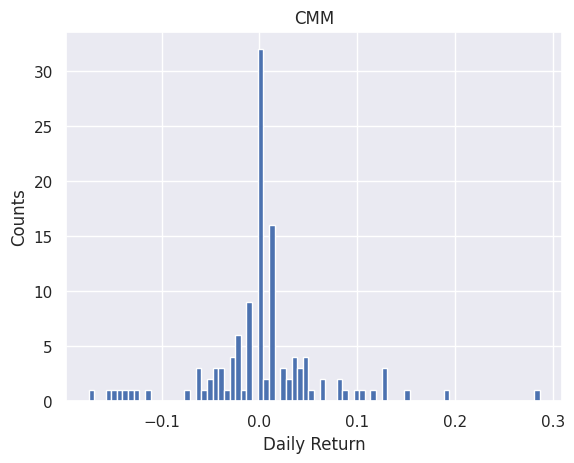

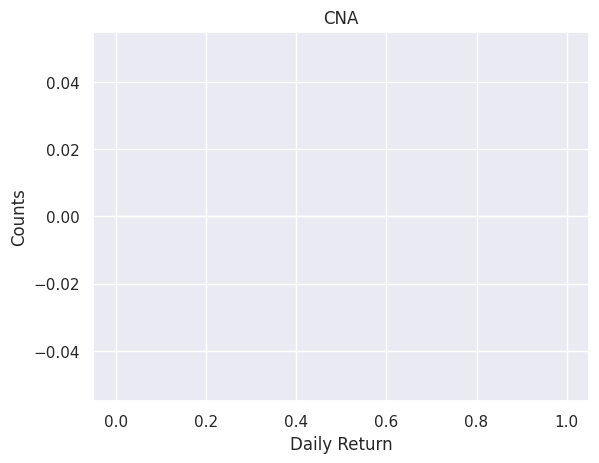

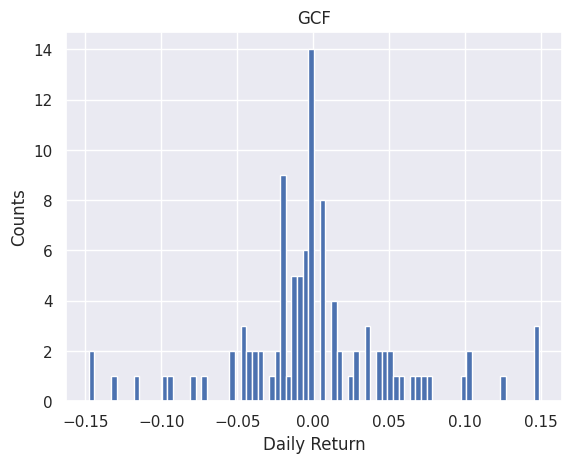

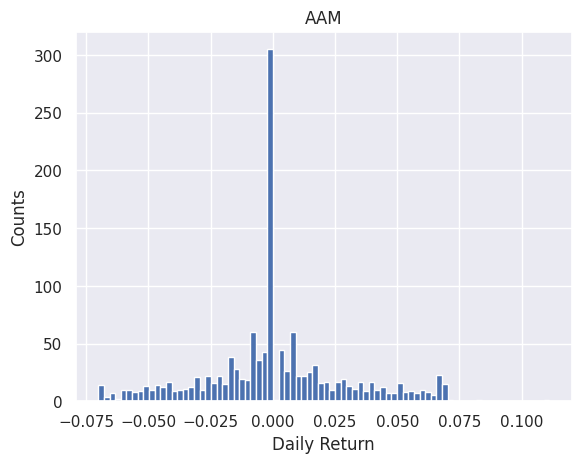

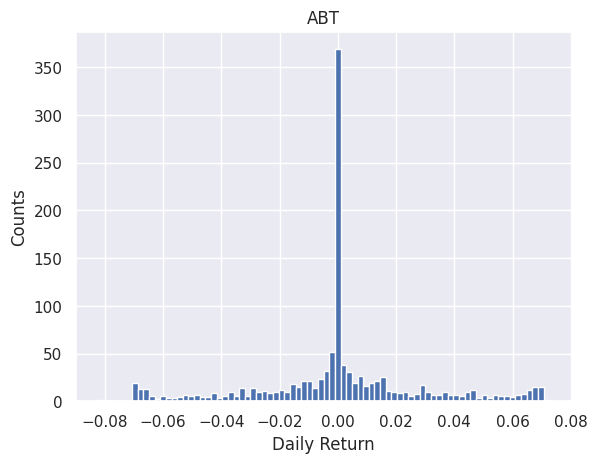

...

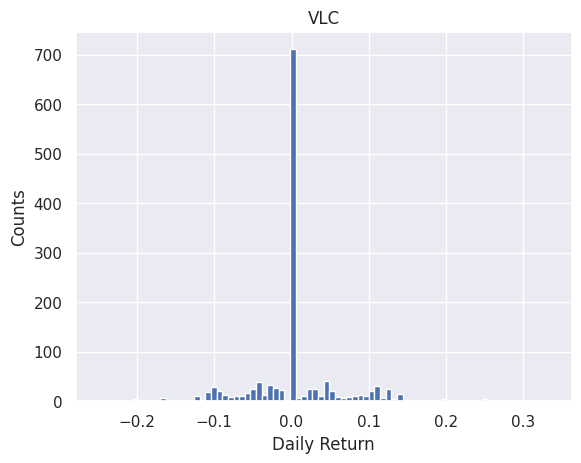

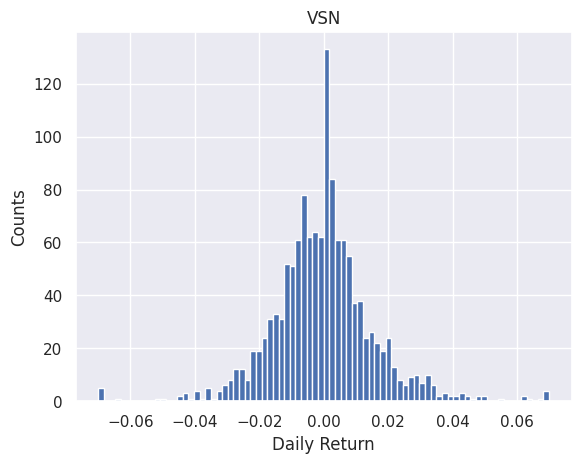

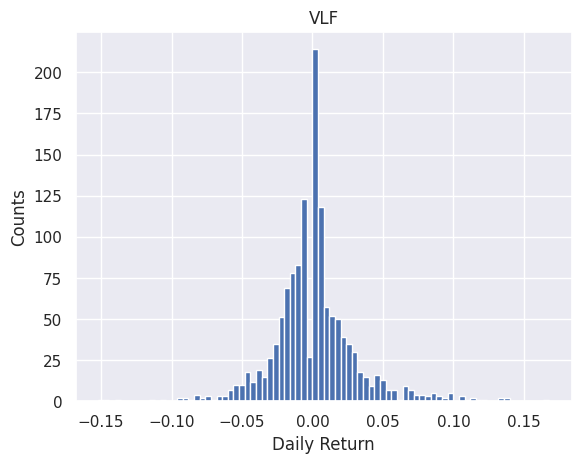

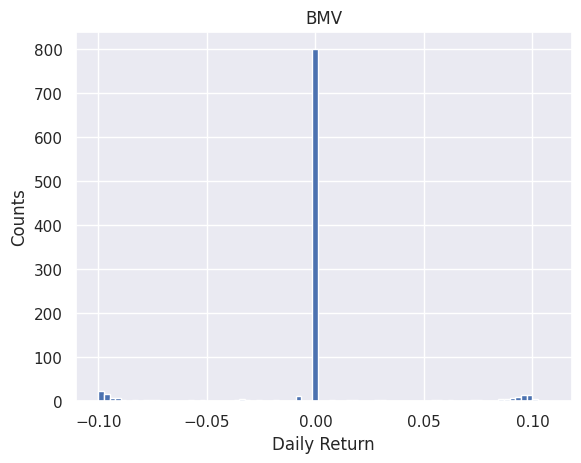

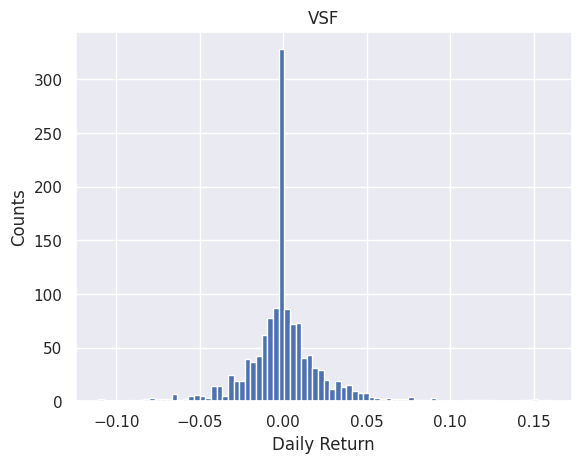

In [ ]:
for i, company in enumerate(lstFnB):
    plt.figure()
    company['Daily Return'].hist(bins=80)
    plt.xlabel('Daily Return')
    plt.ylabel('Counts')
    plt.title(f'{FnB_tickers[i]}')

In [ ]:
FnB_dr = []
for comp in lstFnB:
  FnB_dr.append(comp["Daily Return"])
FnBDR = pd.concat(FnB_dr, axis = 1)

# Check if the number of columns matches the number of tickers
num_columns = FnBDR.shape[1]  # Get the number of columns in FnBDR
num_tickers = len(FnB_tickers)  # Get the number of tickers

# If the numbers don't match, print a warning and truncate the tickers list
if num_columns != num_tickers:
    print(f"Warning: Number of columns ({num_columns}) does not match number of tickers ({num_tickers}).")
    print(f"Truncating the tickers list to match the number of columns.")
    FnB_tickers = FnB_tickers[:num_columns]  # Truncate the list

# Assign the tickers as column names
FnBDR.columns = FnB_tickers
FnBDR

Truncating the tickers list to match the number of columns.


,CMM,CNA,GCF,AAM,ABT,ACL,AGF,AGM,ANT,ANV,...,VCF,VDL,VHC,VHF,SB1,VLC,VSN,VLF,BMV,VSF
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.130357,NaN,0.148876,-0.033846,-0.003064,-0.035032,-0.051618,0.000000,0.0,-0.029040,...,0.000000,0.000000,0.0,0.0,-0.064199,0.000000,0.011420,-0.008703,0.0,-0.025581
2,0.026694,NaN,0.149144,0.000000,0.018955,0.029703,-0.001022,-0.044804,0.0,0.020806,...,0.006907,0.000000,0.0,0.0,0.000000,0.000000,0.004122,-0.072871,0.0,-0.006218
3,0.054000,NaN,0.148936,0.044586,-0.006033,-0.006410,0.033252,0.046905,0.0,0.000000,...,-0.006860,0.012308,-0.2,0.0,0.009786,0.000000,-0.005801,0.067235,0.0,0.007647
4,0.011385,NaN,0.101852,-0.004573,-0.019221,-0.064516,-0.030078,-0.022969,0.0,-0.010191,...,0.011512,-0.012158,0.0,0.0,0.000000,0.099760,-0.016607,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1342,NaN,NaN,NaN,0.000000,NaN,0.000000,NaN,-0.071804,NaN,-0.003248,...,-0.006203,NaN,NaN,NaN,NaN,0.052632,-0.017415,0.000000,NaN,NaN
1343,NaN,NaN,NaN,NaN,NaN,-0.004367,NaN,-0.001887,NaN,0.000000,...,-0.012483,NaN,NaN,NaN,NaN,-0.050000,-0.011707,0.012207,NaN,NaN
1344,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,...,0.050562,NaN,NaN,NaN,NaN,0.052632,NaN,0.003859,NaN,NaN
1345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.012032,NaN,NaN,NaN,NaN,-0.050000,NaN,-0.008169,NaN,NaN


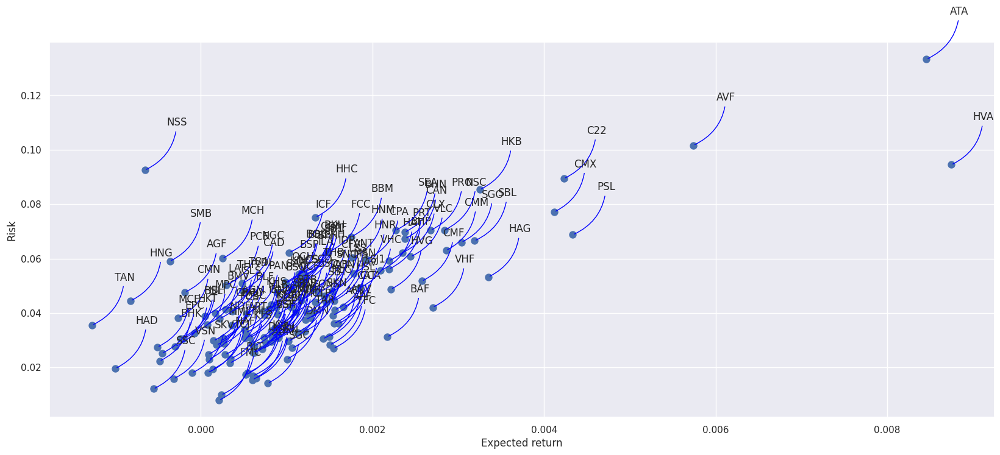

In [ ]:
area = np.pi * 20

plt.figure(figsize=(20, 8))
plt.scatter(FnBDR.mean(), FnBDR.std(), s=area)
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(FnBDR.columns, FnBDR.mean(), FnBDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))

# Personal & HouseHold Goods

In [ ]:
# Vietnam stock information crawling
# https://github.com/thinh-vu/vnstock

from vnstock import *### Split the dataset into time windows to get data samples.

lstgoods = []

goods_tickers = ["SGI", "AAT", "AG1", "ASA", "A32", "BBT", "BDG", "BEL", "BKG", "BMG", "BVN", "STK",
    "CLC", "DCG", "ADS", "DCS", "DM7", "DQC", "DTN", "MGG", "EVE", "FBA", "FTM", "G20",
    "M10", "GDT", "GIL", "GLT", "GMC", "HCB", "HLT", "HSM", "HDM", "HJC", "HTG", "HNI",
    "HUG", "KMR", "KSD", "LGM", "LIX", "MPT", "NJC", "NET", "MNB", "NHT", "NST", "NTT",
    "PNJ", "PPH", "PTG", "RAL", "MSH", "SHE", "SPB", "SSF", "SVD", "TCM", "GTD", "TDT",
    "CET", "TET", "TLG", "TLI", "TNG", "TTG", "VDN", "NDT", "TVT", "VGT", "VGG", "VTI",
    "VTJ", "X20", "X26", "XPH", "XHC"]


for comp in goods_tickers:
  try:
    goods_data = stock_historical_data(comp, "2018-01-01", "2023-05-24")
    lstgoods.append(goods_data)
  except Exception as e:
    print(f"Error processing {comp}: {str(e)}")
    continue  # Move to the next ticker in the list


Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing DTN: local variable 'df' referenced before assignment


In [ ]:
lstgoods[0]

,time,open,high,low,close,volume,ticker
0,2021-09-14,41110,41110,27410,29170,296900,SGI
1,2021-09-15,31330,31330,27410,27410,58000,SGI
2,2021-09-16,27610,27610,23690,24470,2700,SGI
3,2021-09-17,24470,24470,22220,22710,106100,SGI
4,2021-09-20,23000,26430,22610,26430,65400,SGI
...,...,...,...,...,...,...,...
360,2023-05-16,19480,19480,19480,19480,4000,SGI
361,2023-05-18,17720,17720,17720,17720,3100,SGI
362,2023-05-19,16350,18400,16350,18400,3800,SGI
363,2023-05-22,18500,18500,18500,18500,100,SGI


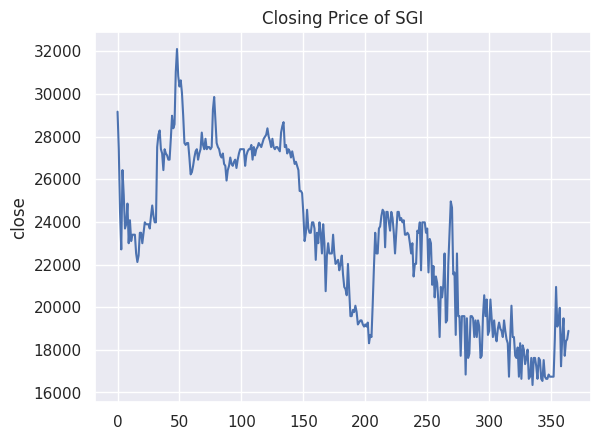

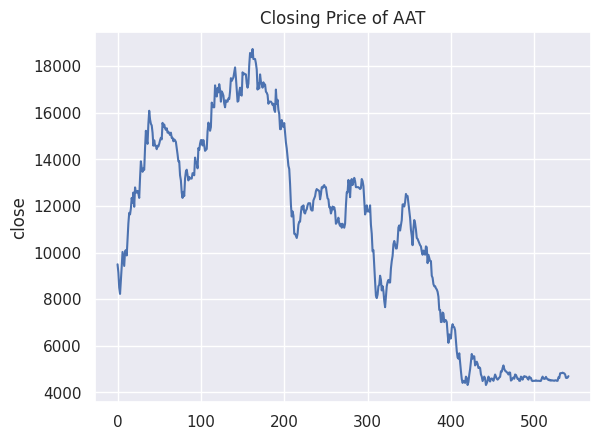

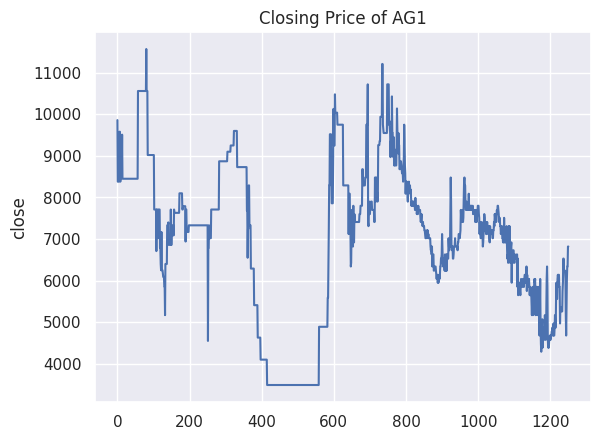

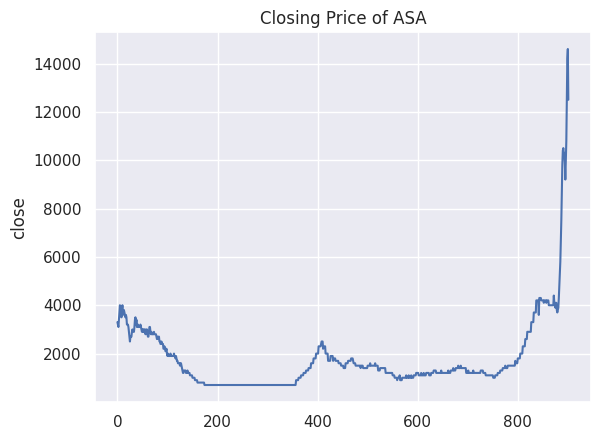

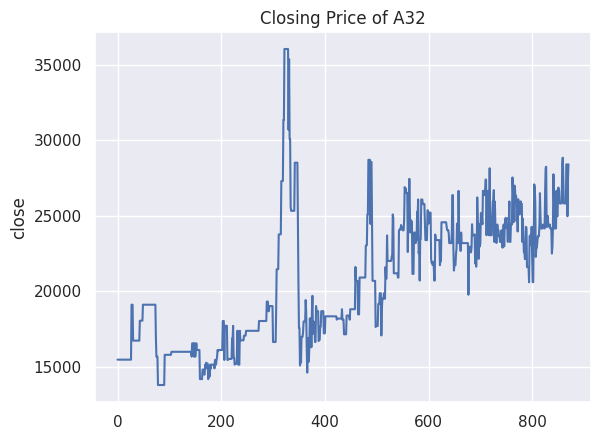

...

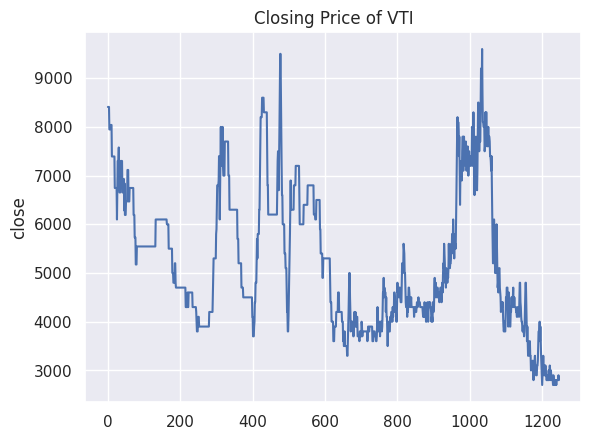

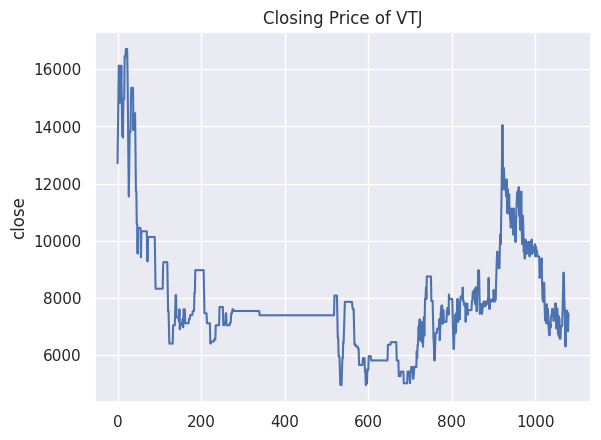

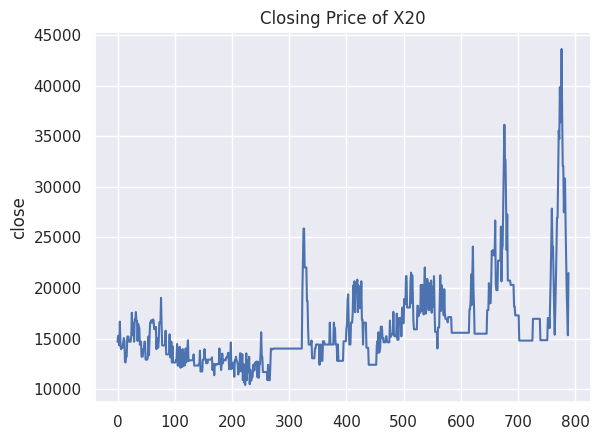

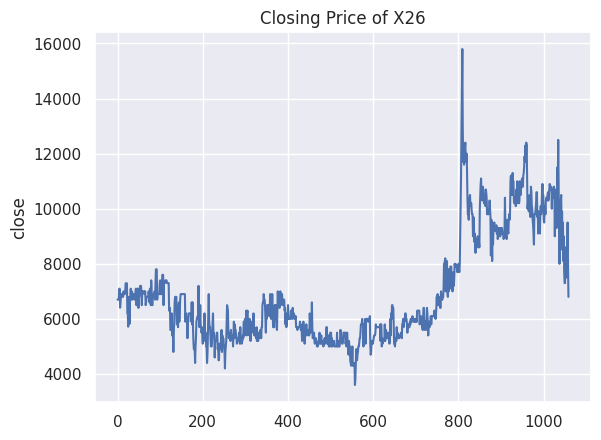

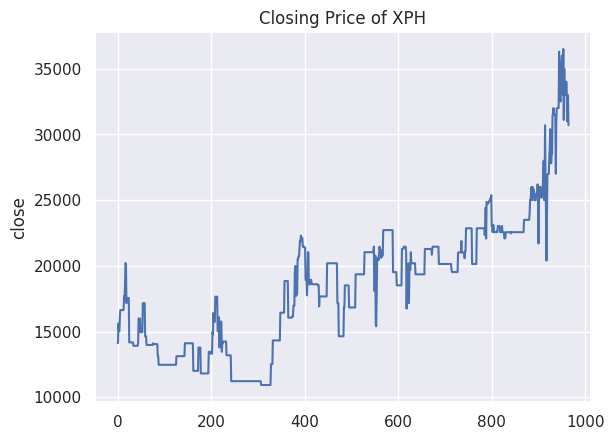

<Figure size 640x480 with 0 Axes>

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstgoods):
    company['close'].plot()
    plt.ylabel('close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {goods_tickers[i]}")
    plt.show()

plt.tight_layout()

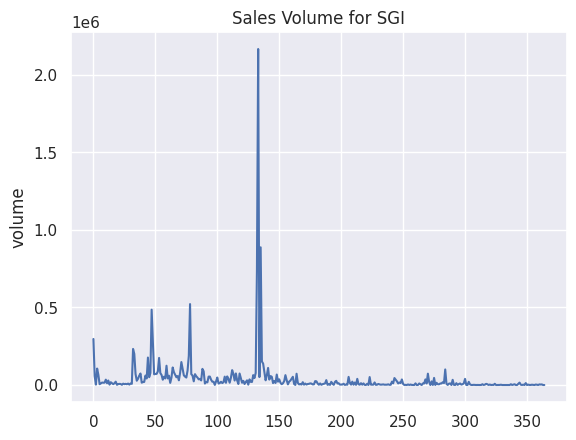

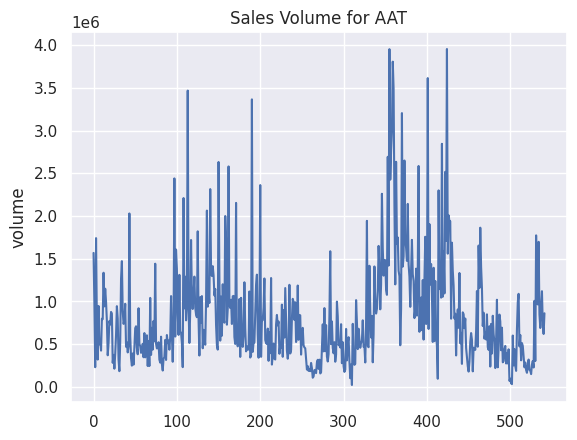

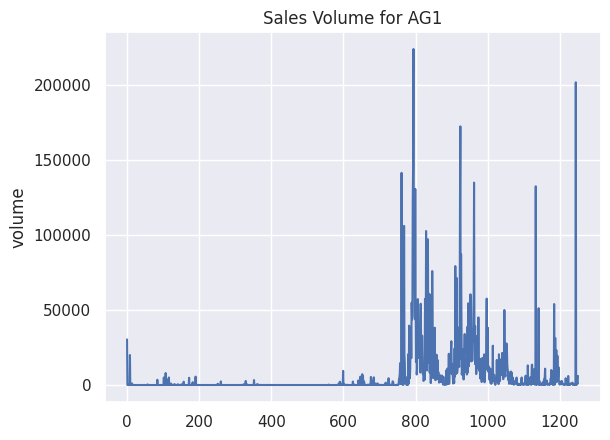

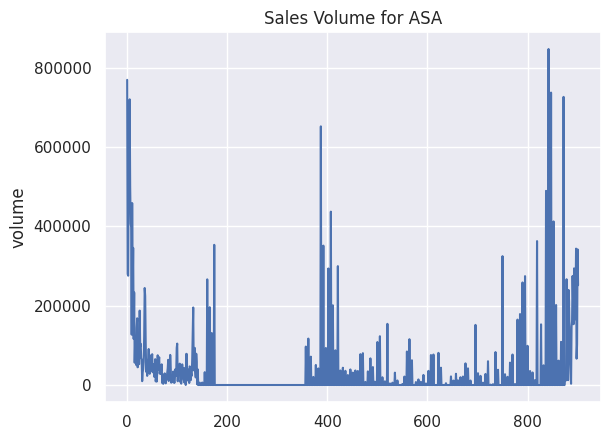

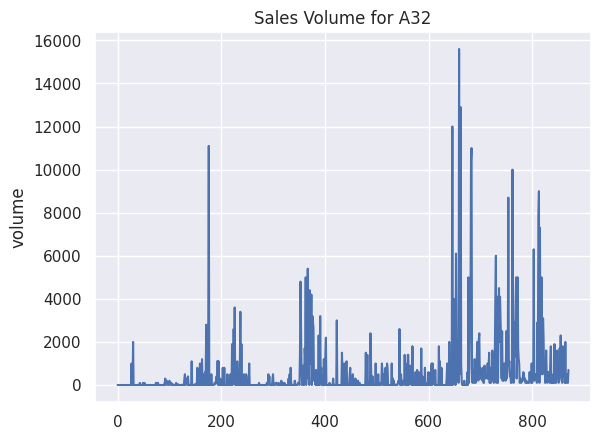

...

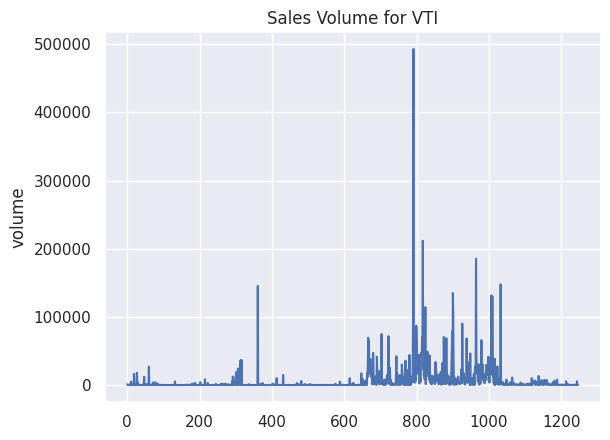

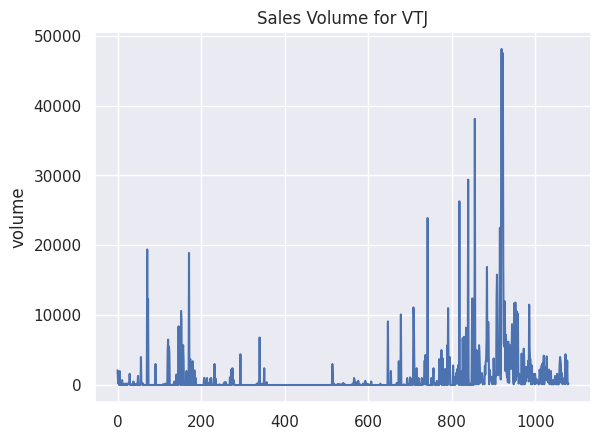

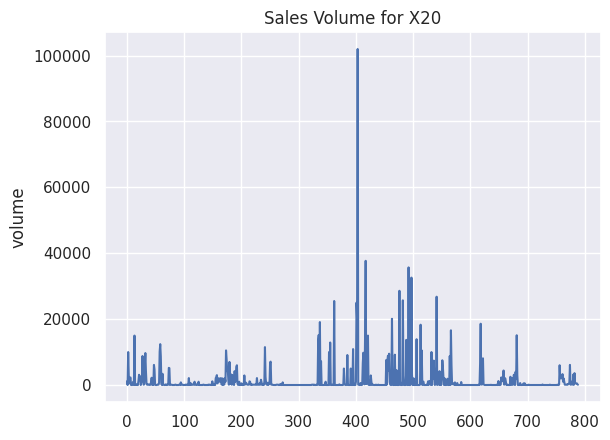

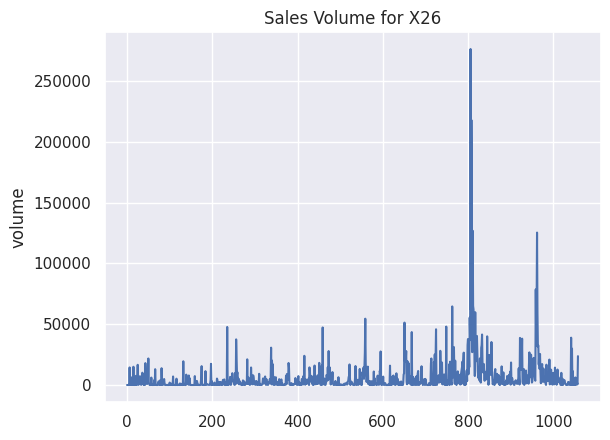

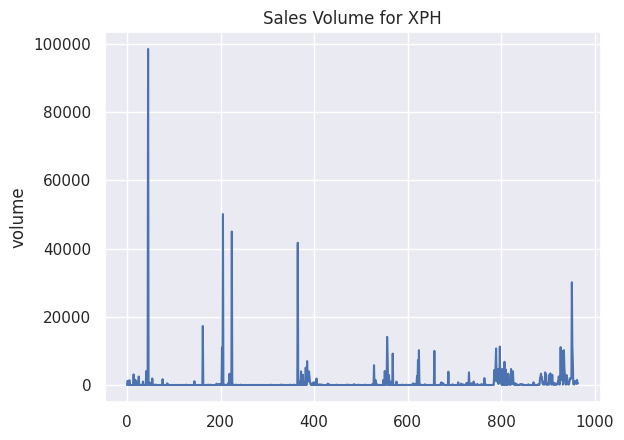

<Figure size 640x480 with 0 Axes>

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstgoods):
    company['volume'].plot()
    plt.ylabel('volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume for {goods_tickers[i]}")
    plt.show()

plt.tight_layout()

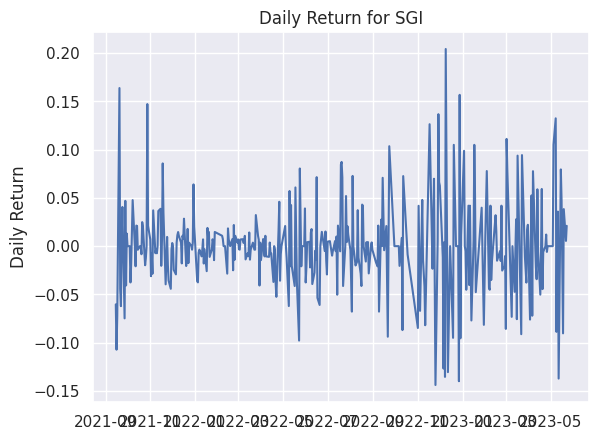

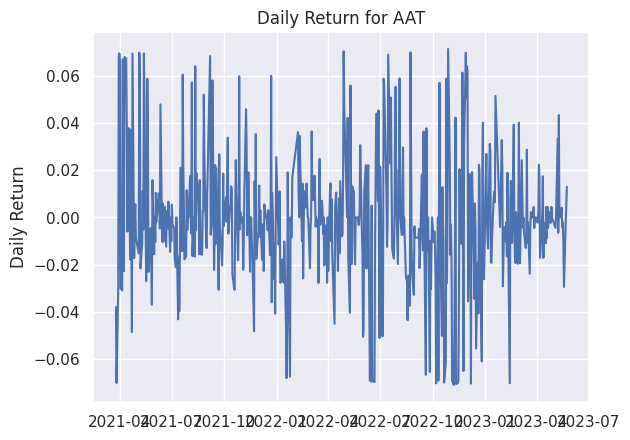

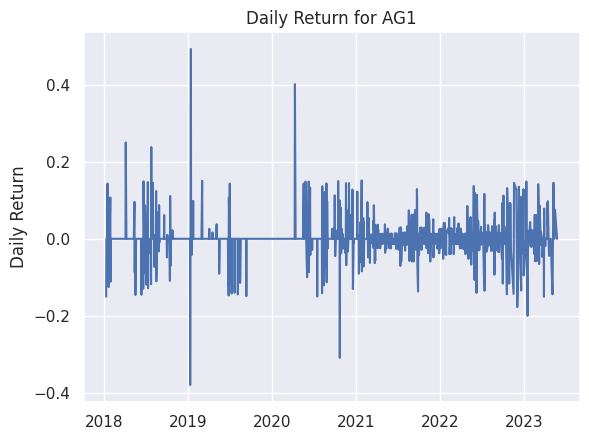

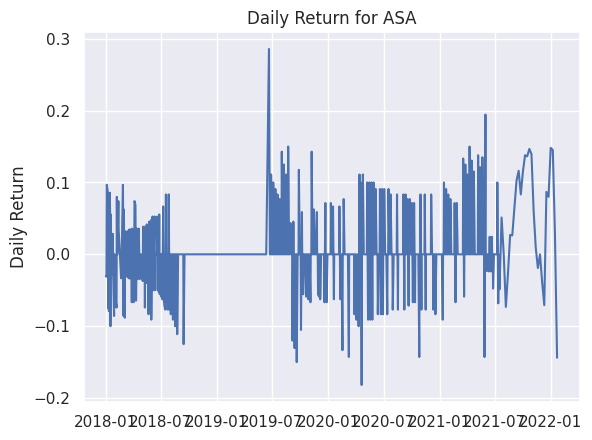

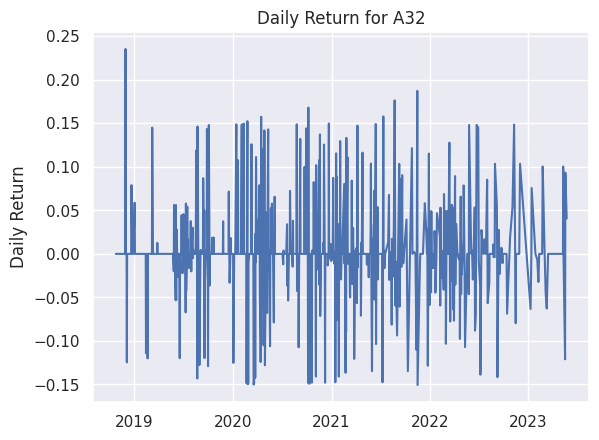

...

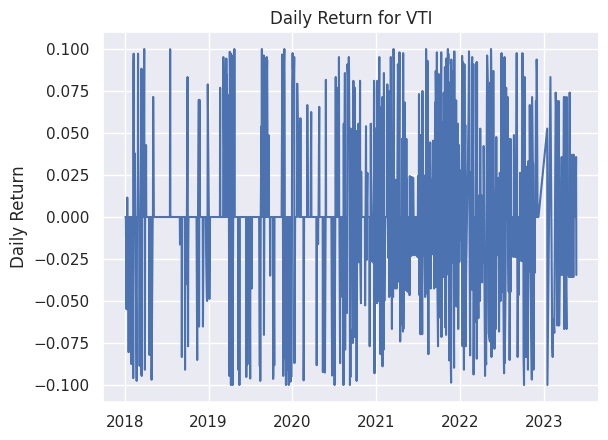

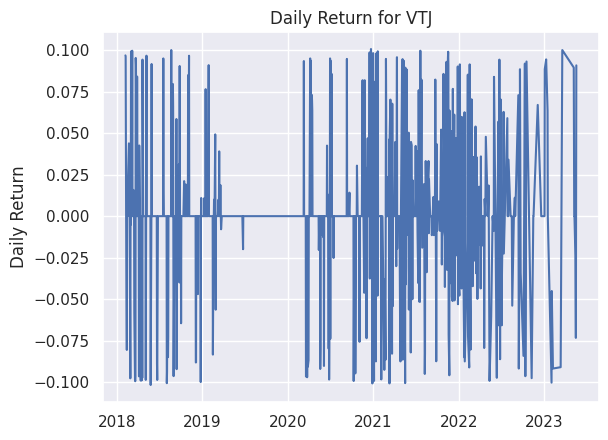

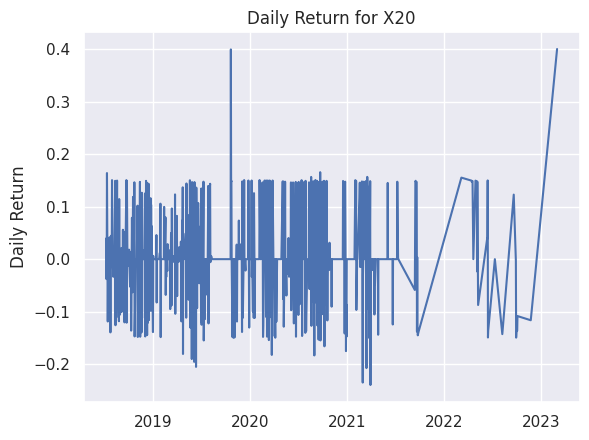

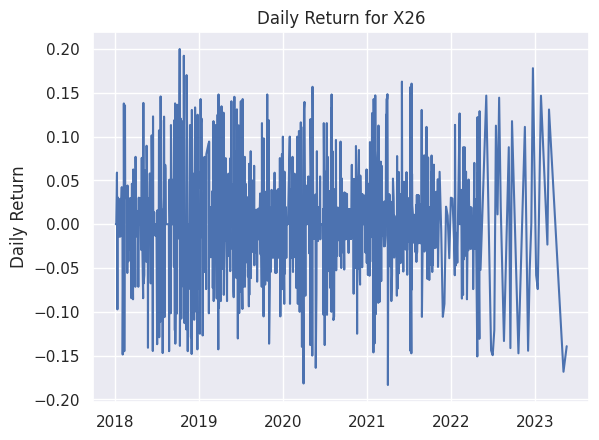

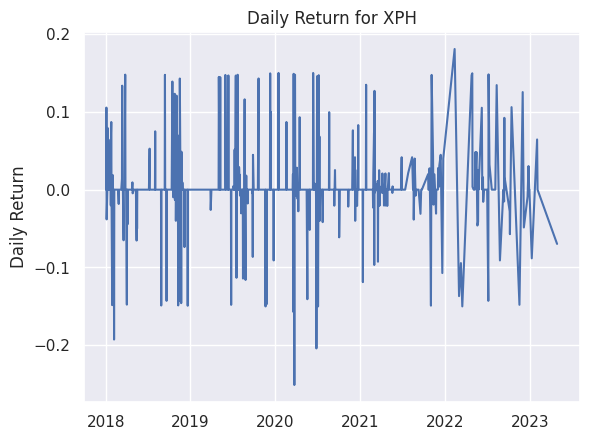

In [ ]:
# We'll use pct_change to find the percent change for each day
for i,company in enumerate(lstgoods):
    company['Daily Return'] = company['close'].pct_change()
    plt.plot(company["time"], company["Daily Return"])
    plt.ylabel('Daily Return')
    plt.xlabel(None)
    plt.title(f"Daily Return for {goods_tickers[i]}")
    plt.show()

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


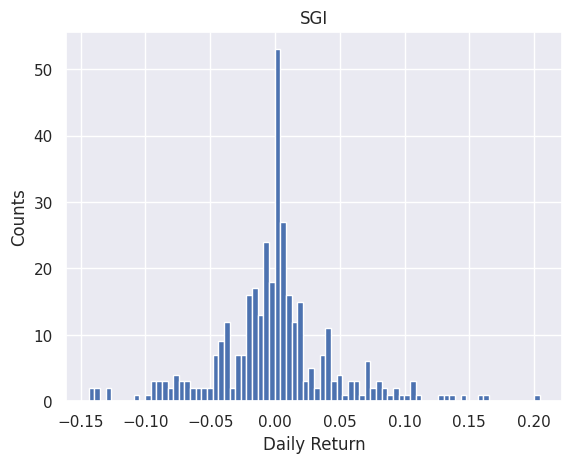

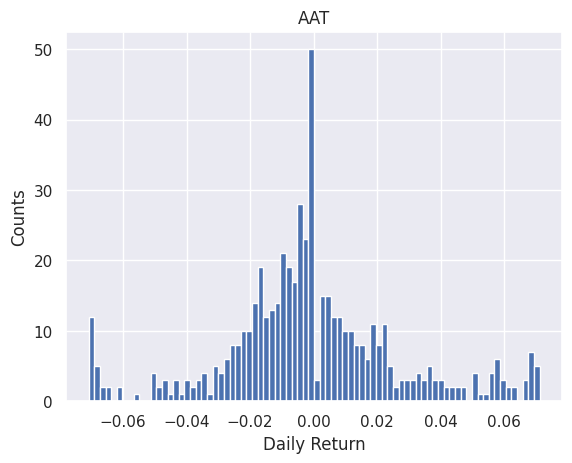

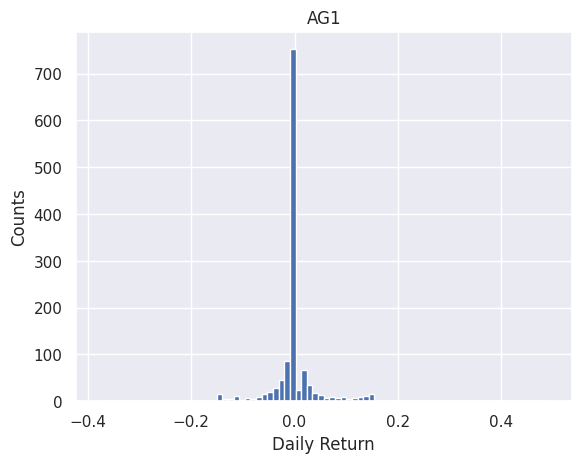

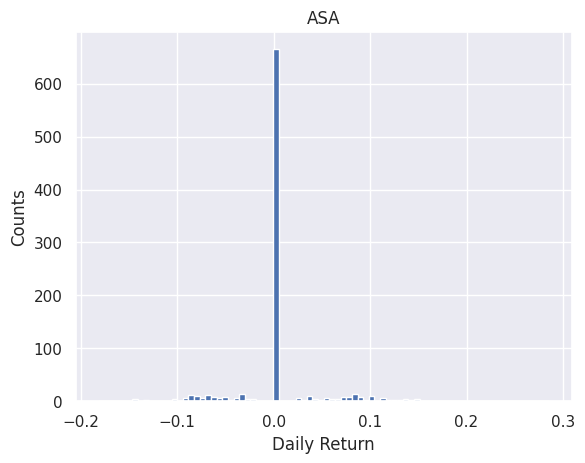

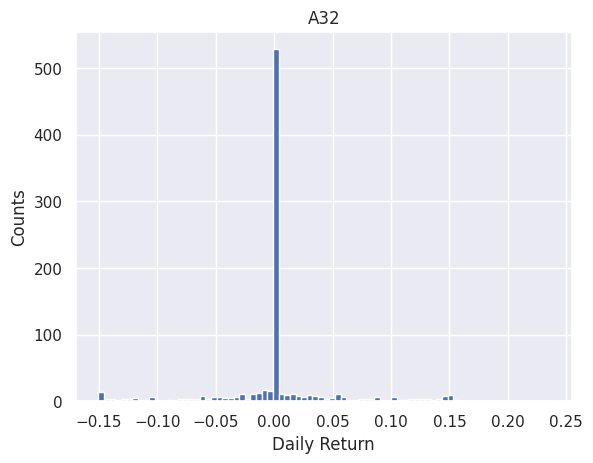

...

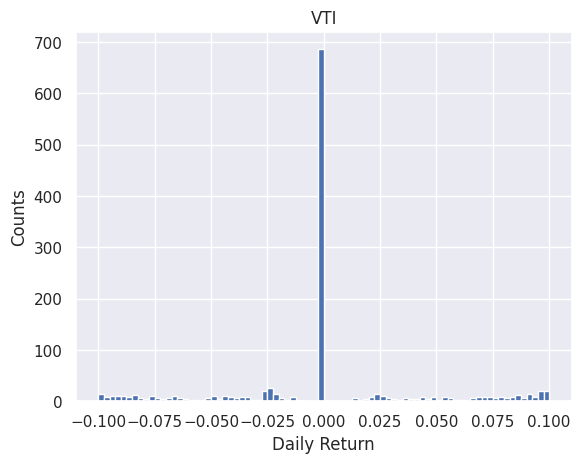

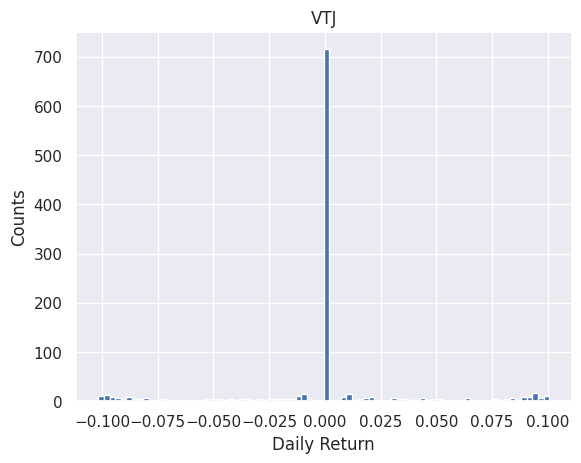

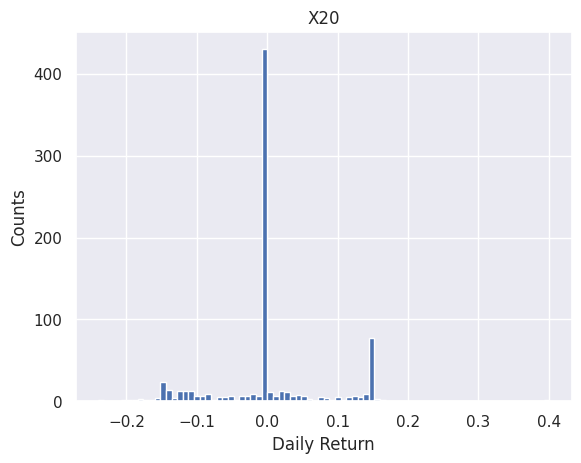

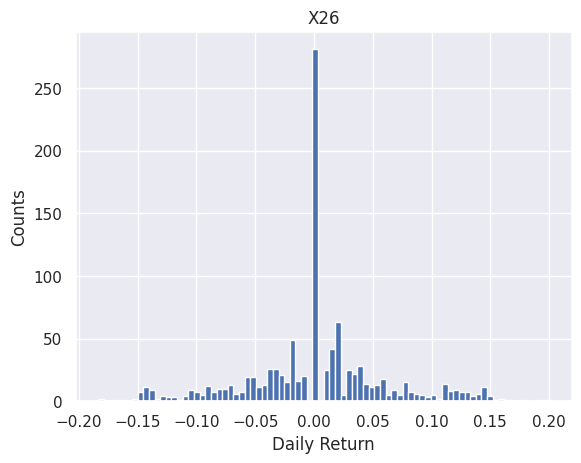

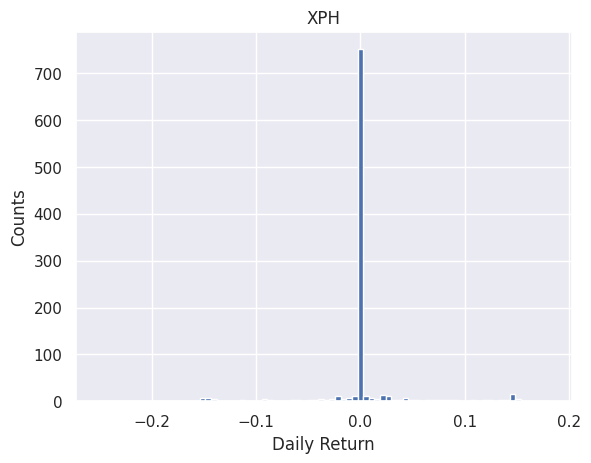

In [ ]:
for i, company in enumerate(lstgoods):
    plt.figure()
    company['Daily Return'].hist(bins=80)
    plt.xlabel('Daily Return')
    plt.ylabel('Counts')
    plt.title(f'{goods_tickers[i]}')

In [ ]:
goods_dr = []
for comp in lstgoods:
  goods_dr.append(comp["Daily Return"])
goodsDR = pd.concat(goods_dr, axis = 1)

# Check if the number of columns matches the number of tickers
num_columns = goodsDR.shape[1]  # Get the number of columns in goodsDR
num_tickers = len(goods_tickers)  # Get the number of tickers

# If the numbers don't match, print a warning and truncate the tickers list
if num_columns != num_tickers:
    print(f"Warning: Number of columns ({num_columns}) does not match number of tickers ({num_tickers}).")
    print(f"Truncating the tickers list to match the number of columns.")
    goods_tickers = goods_tickers[:num_columns]  # Truncate the list

# Assign the tickers as column names
goodsDR.columns = goods_tickers
goodsDR

Truncating the tickers list to match the number of columns.


,SGI,AAT,AG1,ASA,A32,BBT,BDG,BEL,BKG,BMG,...,VDN,NDT,TVT,VGT,VGG,VTI,VTJ,X20,X26,XPH
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-0.060336,-0.037895,-0.150101,-0.030303,0.0,0.124845,0.019727,0.0,0.068241,0.0,...,0.0,-0.001080,0.143353,-0.015890,0.0,0.000000,0.096774,0.039483,0.000000,0.000000
2,-0.107260,-0.070022,0.000000,-0.031250,0.0,0.138920,0.000000,0.0,0.067158,0.0,...,0.0,0.011892,0.094034,0.009150,0.0,0.000000,0.096126,-0.037983,0.000000,0.105464
3,-0.071925,-0.031765,0.000000,0.096774,0.0,0.146176,0.000000,0.0,0.069839,0.0,...,0.0,-0.010684,-0.063771,0.001333,0.0,0.000000,0.055563,-0.025187,0.000000,-0.038161
4,0.163804,0.068044,0.000000,0.088235,0.0,0.149212,0.000000,0.0,0.062410,0.0,...,0.0,-0.032397,0.053307,0.002130,0.0,-0.054935,0.000000,0.164106,0.058938,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-0.008287,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1342,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1343,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,0.017642,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1344,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-0.017336,NaN,NaN,NaN,NaN,NaN,NaN,NaN


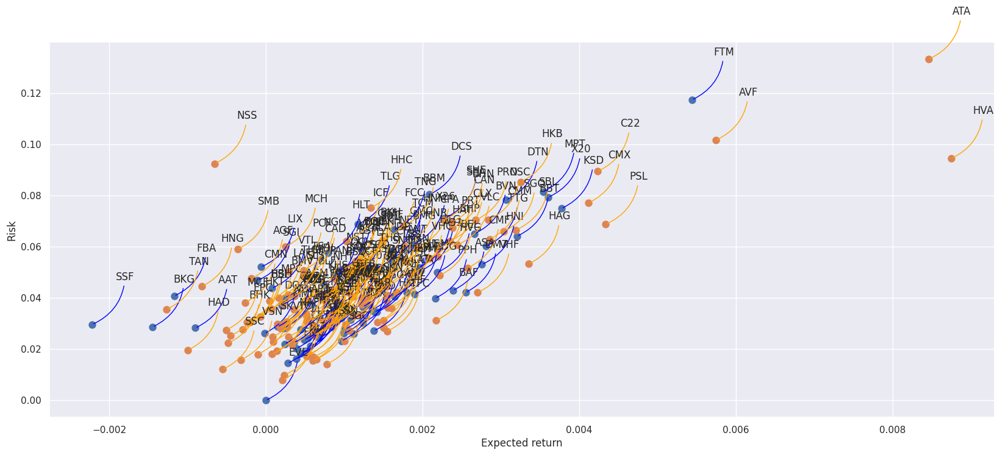

In [ ]:
area = np.pi * 20

plt.figure(figsize=(20, 8))
plt.scatter(goodsDR.mean(), goodsDR.std(), s=area)
plt.scatter(FnBDR.mean(), FnBDR.std(), s=area)
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(goodsDR.columns, goodsDR.mean(), goodsDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))
for label, x, y in zip(FnBDR.columns, FnBDR.mean(), FnBDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='orange', connectionstyle='arc3,rad=-0.3'))

# Retails

In [ ]:
# Vietnam stock information crawling
# https://github.com/thinh-vu/vnstock
from vnstock import *### Split the dataset into time windows to get data samples.

lstTech = []

Tech_tickers = ['CKV', 'CMG', 'CMT', 'ICT', 'ELC', 'FPT', 'HIG', 'HPT', 'ITD', 'KST',
    'LTC', 'ONE', 'PMJ', 'PMT', 'POT', 'SAM', 'SBD', 'SGT', 'SMT', 'SRA',
    'SRB', 'ST8', 'TST', 'UNI', 'VAT', 'VEC', 'VIE', 'VLA', 'VTC', 'VTE']

for comp in Tech_tickers:
  try:
    Tech_data = stock_historical_data(comp, "2018-01-01", "2023-05-24")
    lstTech.append(Tech_data)
  except Exception as e:
    print(f"Error processing {comp}: {str(e)}")
    continue  # Move to the next ticker in the list

Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing VAT: local variable 'df' referenced before assignment


In [ ]:
lstTech[0]

,time,open,high,low,close,volume,ticker
0,2018-01-02,11010,11010,11010,11010,0,CKV
1,2018-01-03,11010,11010,11010,11010,0,CKV
2,2018-01-04,11010,11010,11010,11010,0,CKV
3,2018-01-05,11010,11010,11010,11010,0,CKV
4,2018-01-08,11010,11010,11010,11010,0,CKV
...,...,...,...,...,...,...,...
1000,2023-05-16,10940,10940,10940,10940,3500,CKV
1001,2023-05-18,11620,11620,11620,11620,1000,CKV
1002,2023-05-19,11700,11700,11540,11540,200,CKV
1003,2023-05-22,11110,11110,11110,11110,100,CKV


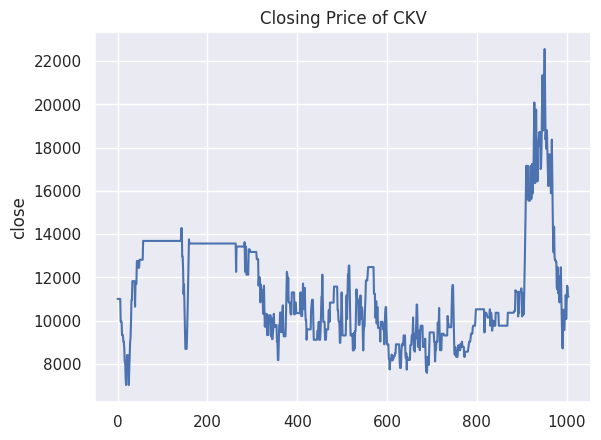

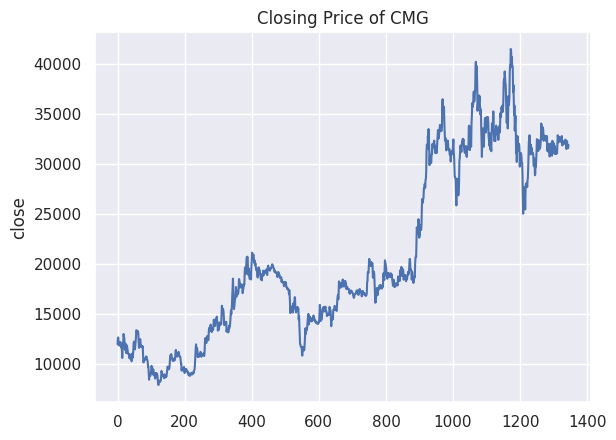

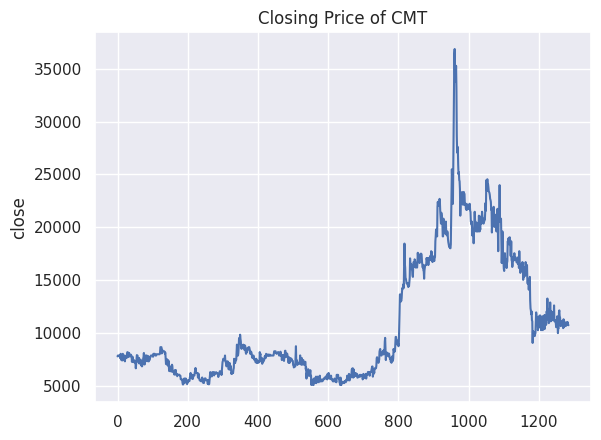

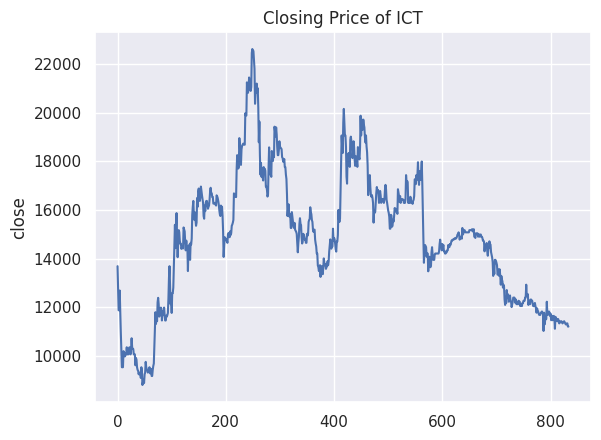

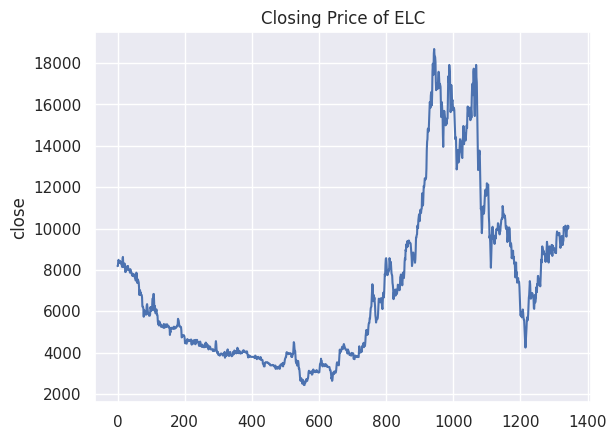

...

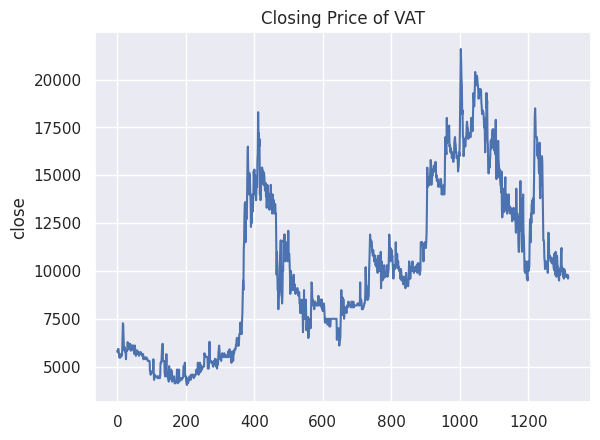

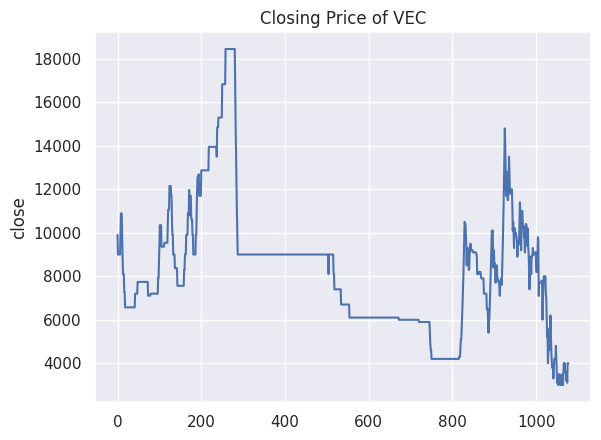

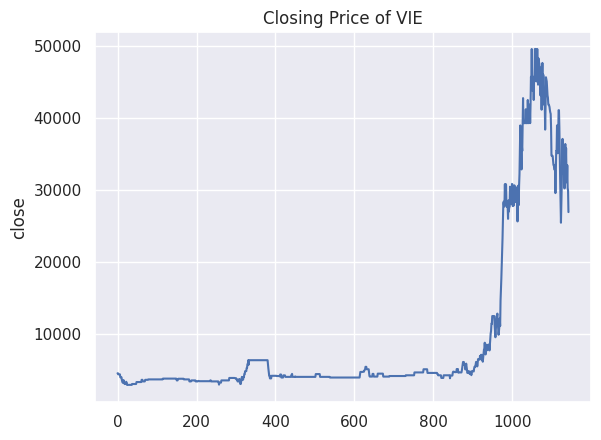

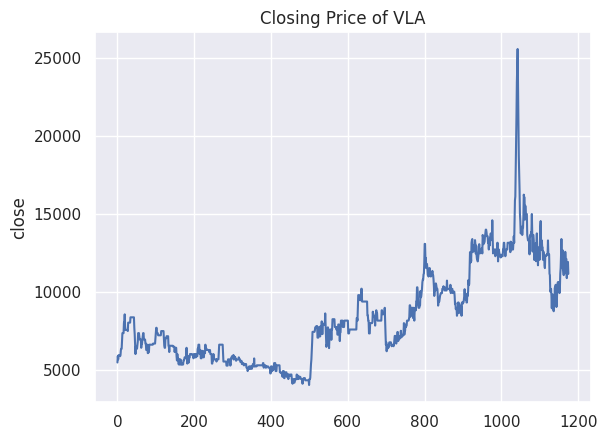

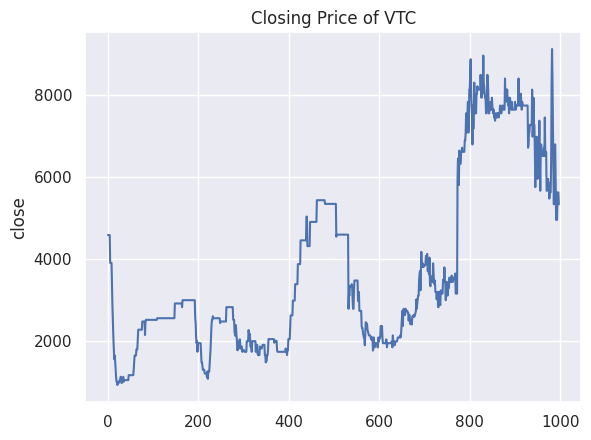

<Figure size 640x480 with 0 Axes>

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstTech):
    company['close'].plot()
    plt.ylabel('close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {Tech_tickers[i]}")
    plt.show()

plt.tight_layout()

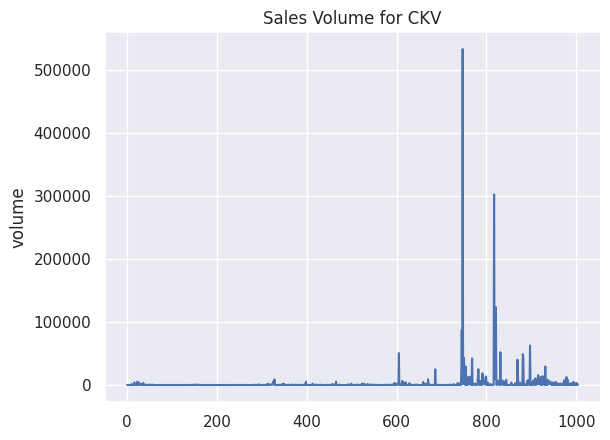

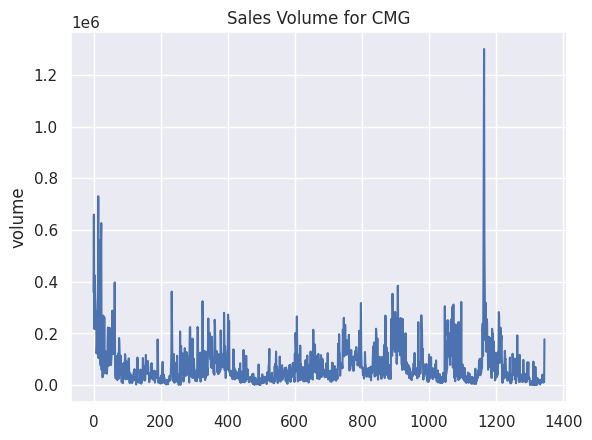

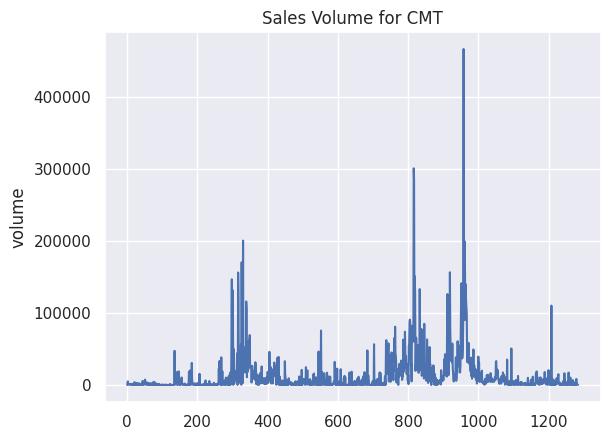

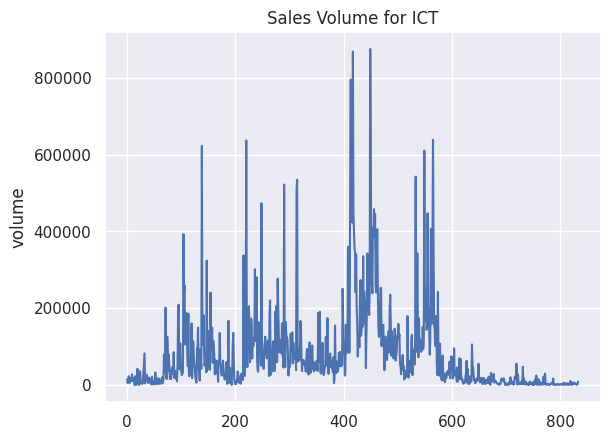

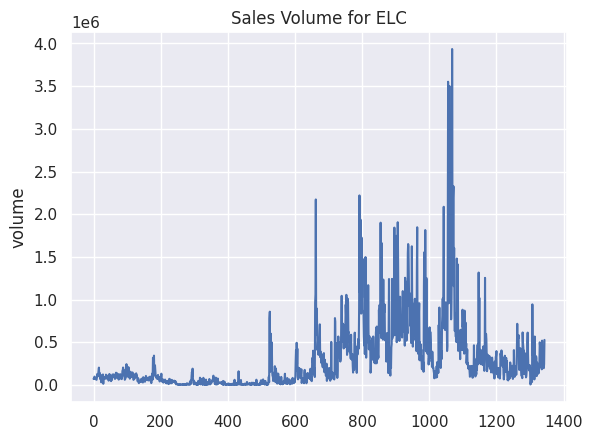

...

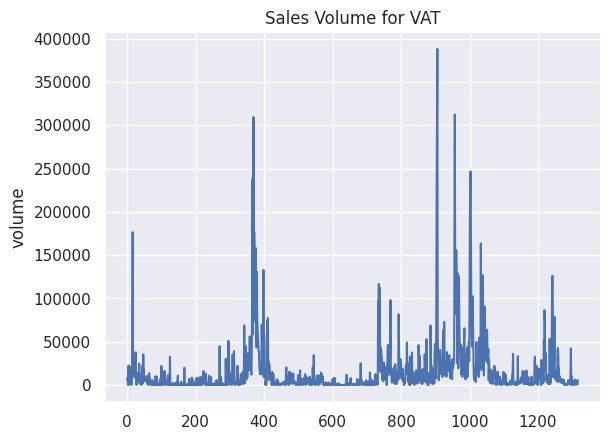

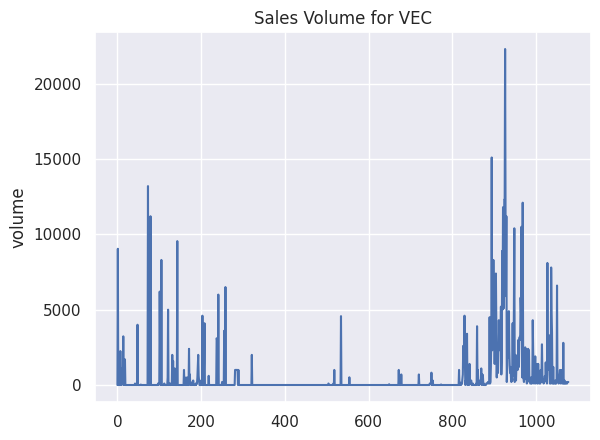

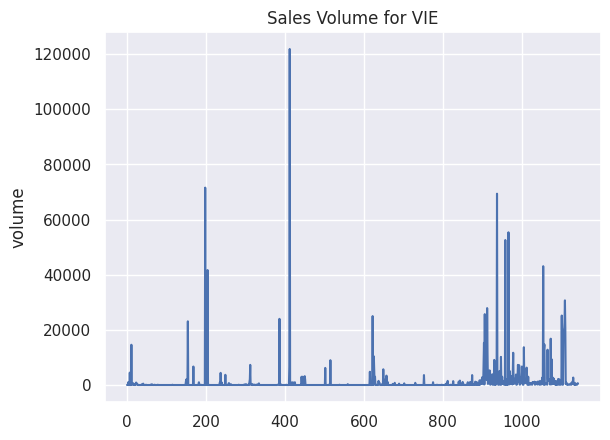

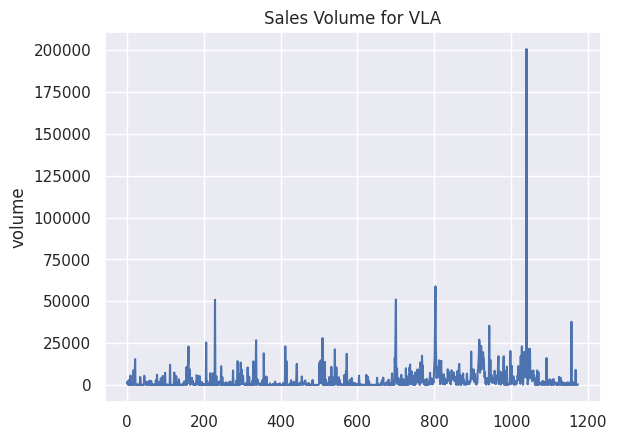

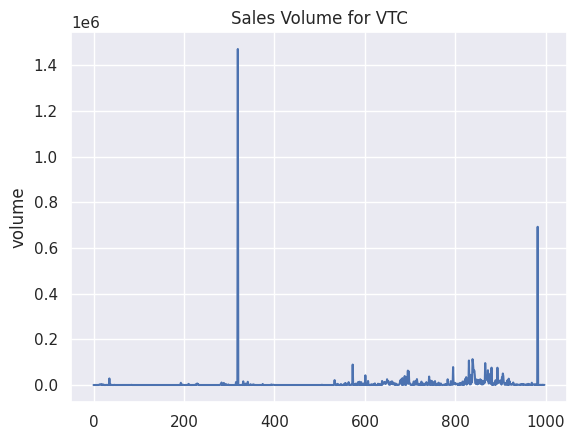

<Figure size 640x480 with 0 Axes>

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(lstTech):
    company['volume'].plot()
    plt.ylabel('volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume for {Tech_tickers[i]}")
    plt.show()

plt.tight_layout()

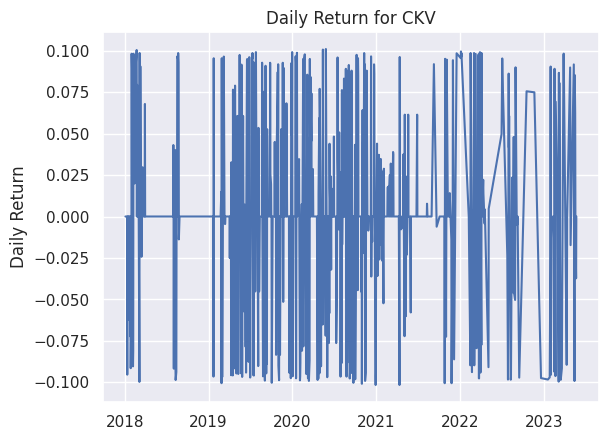

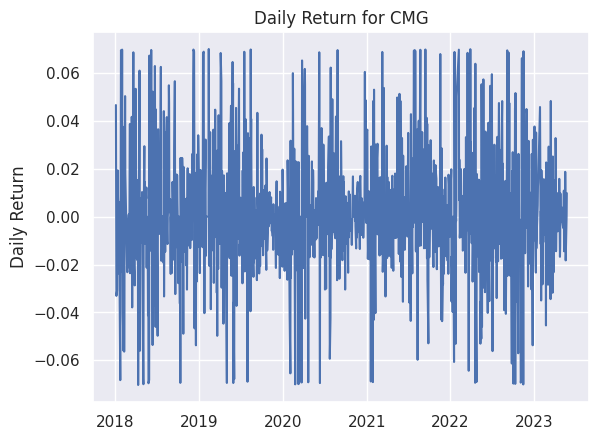

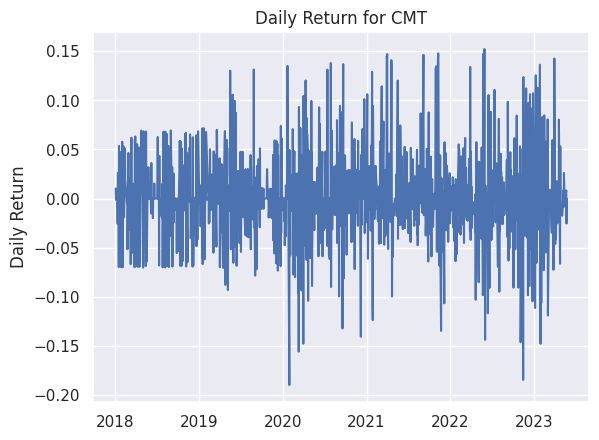

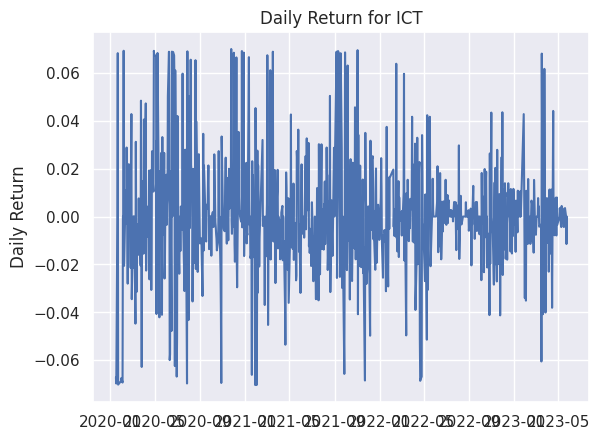

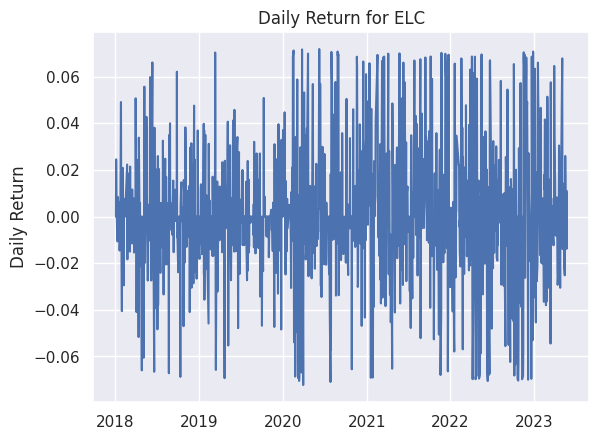

...

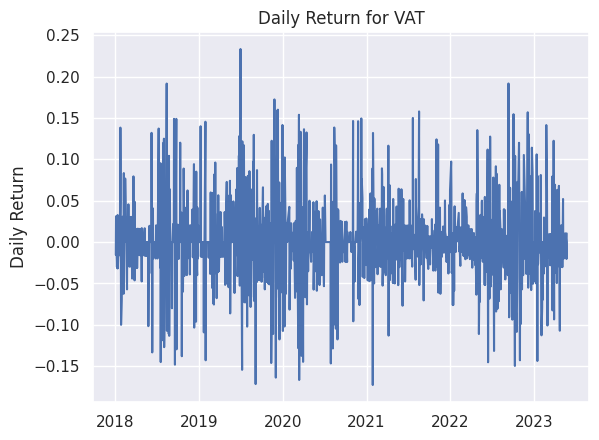

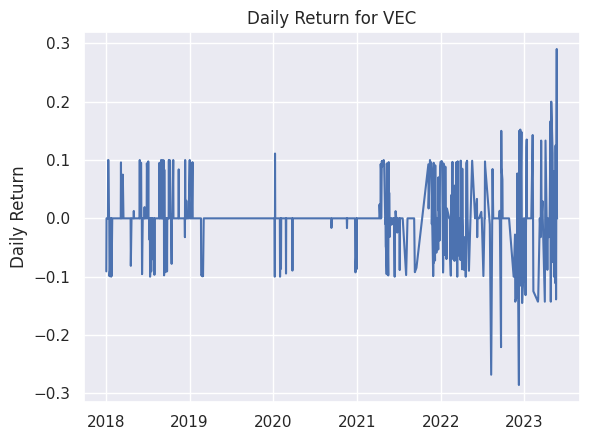

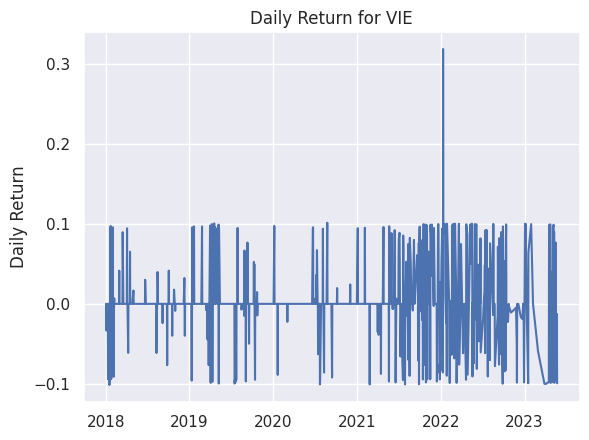

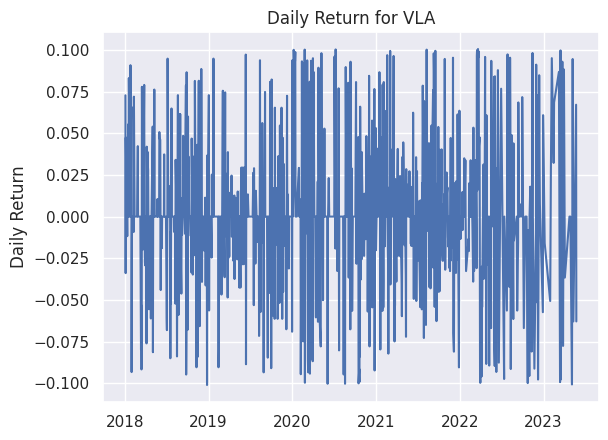

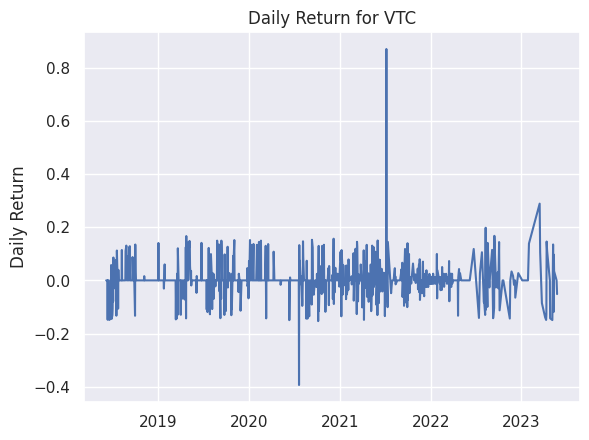

In [ ]:
# We'll use pct_change to find the percent change for each day
for i,company in enumerate(lstTech):
    company['Daily Return'] = company['close'].pct_change()
    plt.plot(company["time"], company["Daily Return"])
    plt.ylabel('Daily Return')
    plt.xlabel(None)
    plt.title(f"Daily Return for {Tech_tickers[i]}")
    plt.show()

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.


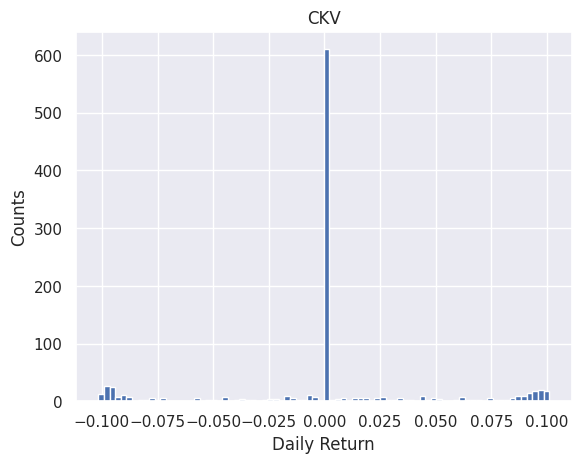

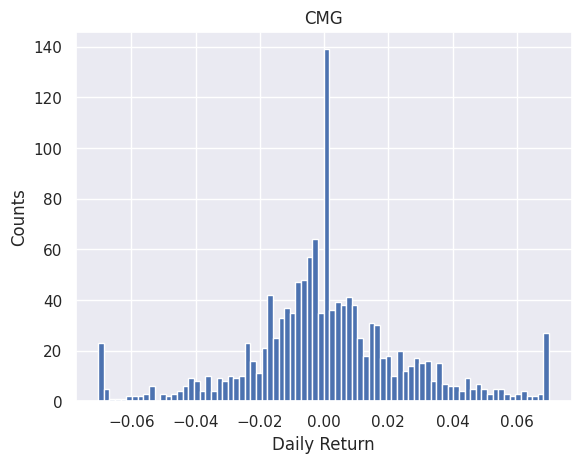

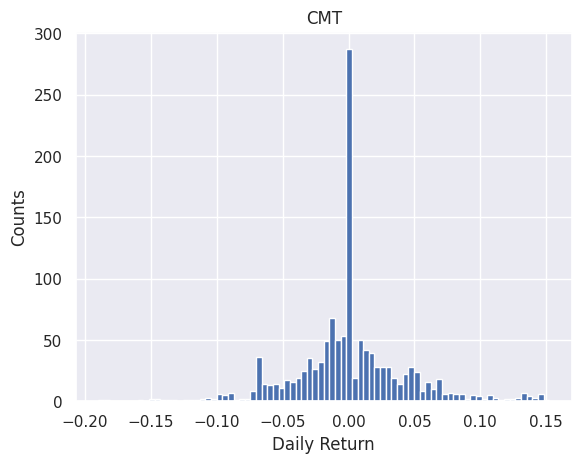

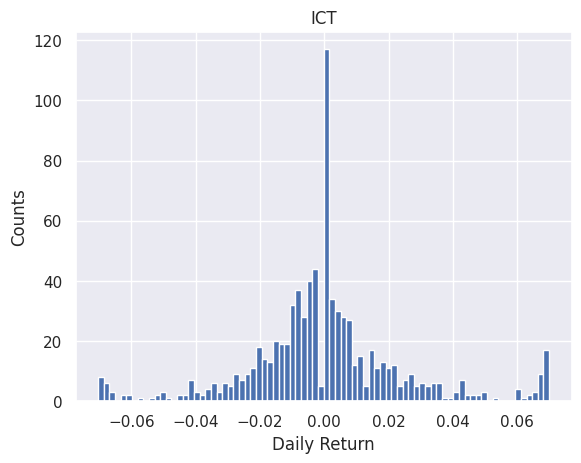

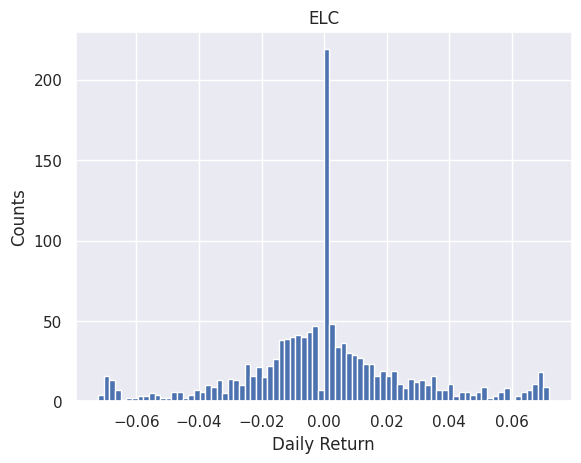

...

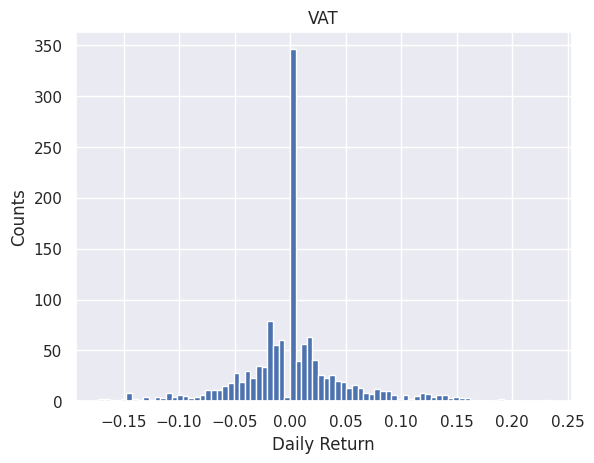

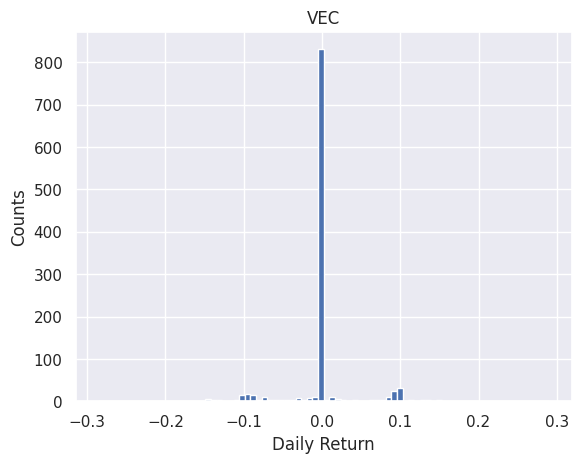

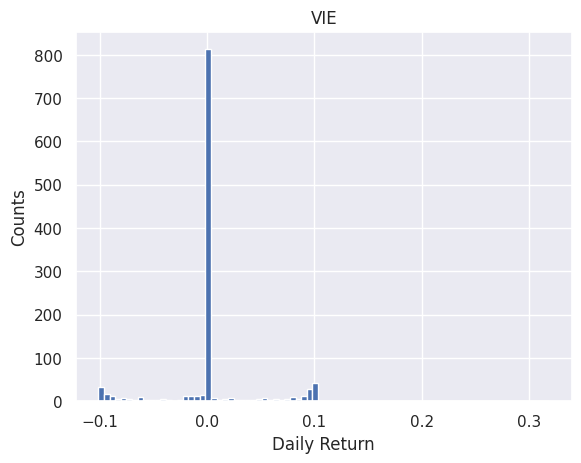

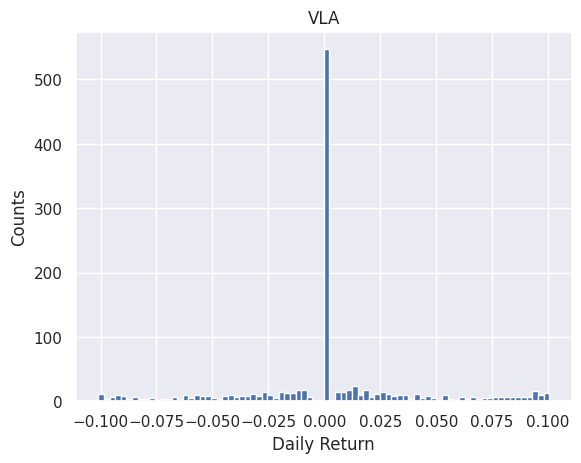

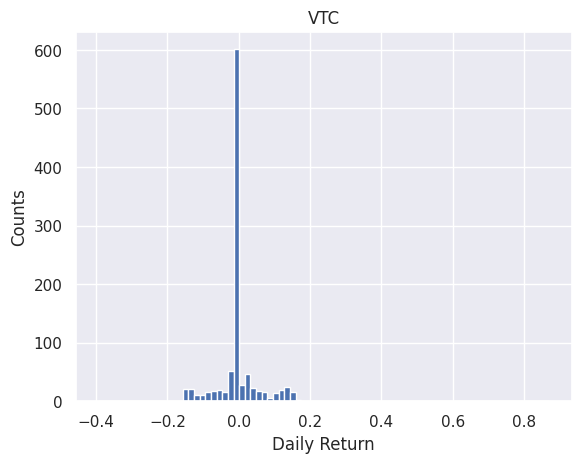

In [ ]:
for i, company in enumerate(lstTech):
    plt.figure()
    company['Daily Return'].hist(bins=80)
    plt.xlabel('Daily Return')
    plt.ylabel('Counts')
    plt.title(f'{Tech_tickers[i]}')

In [ ]:
Tech_dr = []
for comp in lstTech:
  Tech_dr.append(comp["Daily Return"])
TechDR = pd.concat(Tech_dr, axis = 1)

# Check if the number of columns matches the number of tickers
num_columns = TechDR.shape[1]  # Get the number of columns in TechDR
num_tickers = len(Tech_tickers)  # Get the number of tickers

# If the numbers don't match, print a warning and truncate the tickers list
if num_columns != num_tickers:
    print(f"Warning: Number of columns ({num_columns}) does not match number of tickers ({num_tickers}).")
    print(f"Truncating the tickers list to match the number of columns.")
    Tech_tickers = Tech_tickers[:num_columns]  # Truncate the list

# Assign the tickers as column names
TechDR.columns = Tech_tickers
TechDR

Truncating the tickers list to match the number of columns.


,CKV,CMG,CMT,ICT,ELC,FPT,HIG,HPT,ITD,KST,...,SRA,SRB,ST8,TST,UNI,VAT,VEC,VIE,VLA,VTC
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,0.046628,0.010283,-0.067202,0.000000,0.000000,0.000000,0.023684,0.015267,0.0,...,0.000000,0.000000,-0.034862,0.0,-0.016667,-0.015427,-0.090909,0.000000,0.072727,0.0
2,0.0,0.009547,-0.001272,-0.069695,0.024545,0.020032,-0.015701,0.000000,0.016165,0.0,...,-0.067535,0.000000,0.036122,0.0,0.016949,0.031163,0.000000,-0.033333,-0.033898,0.0
3,0.0,-0.033097,0.001274,0.000000,0.011919,-0.016985,0.015951,0.000000,-0.030707,0.0,...,0.000000,0.000000,-0.005505,0.0,0.000000,0.000000,0.000000,0.000000,0.047368,0.0
4,0.0,-0.030970,-0.001272,0.068182,-0.007067,0.015659,0.047664,0.000000,0.003817,0.0,...,0.000000,0.000000,-0.010148,0.0,0.083333,-0.030221,0.000000,0.000000,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,NaN,-0.018278,NaN,NaN,0.009960,-0.003785,NaN,NaN,-0.058366,NaN,...,-0.048780,0.050000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1342,NaN,-0.003471,NaN,NaN,-0.013807,-0.012060,NaN,NaN,0.037190,NaN,...,-0.025641,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1343,NaN,0.000000,NaN,NaN,0.011000,-0.002508,NaN,NaN,-0.039841,NaN,...,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1344,NaN,0.009816,NaN,NaN,NaN,NaN,NaN,NaN,0.004149,NaN,...,-0.026316,-0.047619,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
TechDR.dropna(axis=1, thresh=TechDR.shape[0]-3, inplace=True)

In [ ]:
TechDR

,CMG,ELC,FPT,ITD,SAM,SRA,SRB
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.046628,0.000000,0.000000,0.015267,-0.007764,0.000000,0.000000
2,0.009547,0.024545,0.020032,0.016165,-0.012520,-0.067535,0.000000
3,-0.033097,0.011919,-0.016985,-0.030707,-0.006339,0.000000,0.000000
4,-0.030970,-0.007067,0.015659,0.003817,0.017544,0.000000,0.000000
...,...,...,...,...,...,...,...
1341,-0.018278,0.009960,-0.003785,-0.058366,0.015625,-0.048780,0.050000
1342,-0.003471,-0.013807,-0.012060,0.037190,0.047692,-0.025641,0.000000
1343,0.000000,0.011000,-0.002508,-0.039841,-0.005874,0.000000,0.000000
1344,0.009816,NaN,NaN,0.004149,NaN,-0.026316,-0.047619


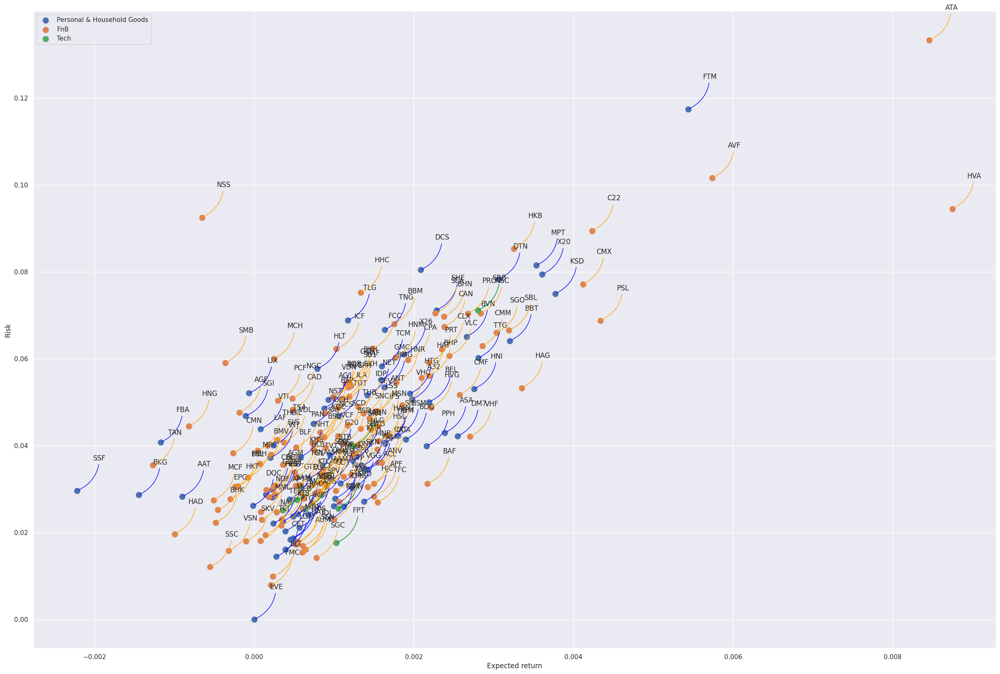

In [ ]:
area = np.pi * 30

plt.figure(figsize=(30, 20))
plt.scatter(goodsDR.mean(), goodsDR.std(), s=area, label = "Personal & Household Goods")
plt.scatter(FnBDR.mean(), FnBDR.std(), s=area, label = "FnB")
plt.scatter(TechDR.mean(), TechDR.std(), s=area, label = "Tech")
plt.legend()
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(goodsDR.columns, goodsDR.mean(), goodsDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))
for label, x, y in zip(FnBDR.columns, FnBDR.mean(), FnBDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='orange', connectionstyle='arc3,rad=-0.3'))
for label, x, y in zip(TechDR.columns, TechDR.mean(), TechDR.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='green', connectionstyle='arc3,rad=-0.3'))

# First Round:

In [ ]:
def choose(df):
  std_values = df.std()
  selected_columns = std_values[(std_values <= 0.025)].index
  new_df = df[selected_columns]
  expected_values = new_df.mean()
  selected_columns = expected_values[(expected_values > 0.0005)].index
  new_df = new_df[selected_columns]
  return new_df

In [ ]:
Tech_choose = choose(TechDR)
FnB_choose = choose(FnBDR)
goods_choose = choose(goodsDR)

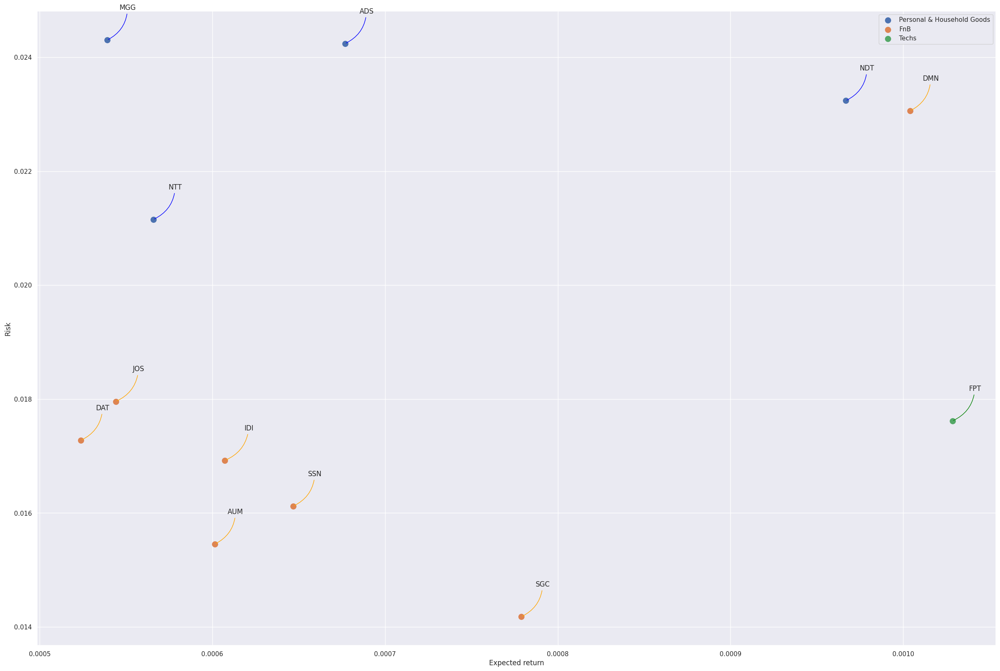

In [ ]:
area = np.pi * 30

plt.figure(figsize=(30, 20))
plt.scatter(goods_choose.mean(), goods_choose.std(), s=area, label = "Personal & Household Goods")
plt.scatter(FnB_choose.mean(), FnB_choose.std(), s=area, label = "FnB")
plt.scatter(Tech_choose.mean(), Tech_choose.std(), s=area, label = "Techs")
plt.legend()
plt.xlabel('Expected return')
plt.ylabel('Risk')

for label, x, y in zip(goods_choose.columns, goods_choose.mean(), goods_choose.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))
for label, x, y in zip(FnB_choose.columns, FnB_choose.mean(), FnB_choose.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='orange', connectionstyle='arc3,rad=-0.3'))
for label, x, y in zip(Tech_choose.columns, Tech_choose.mean(), Tech_choose.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom',
                 arrowprops=dict(arrowstyle='-', color='green', connectionstyle='arc3,rad=-0.3'))

In [ ]:
chosen_round1 = list(FnB_choose.columns) + list(Tech_choose.columns) + list(goods_choose.columns)
chosen_round1

['AUM',
 'DMN',
 'IDI',
 'JOS',
 'DAT',
 'SGC',
 'SSN',
 'FPT',
 'ADS',
 'MGG',
 'NTT',
 'NDT']

In [ ]:
# Vietnam stock information crawling
# https://github.com/thinh-vu/vnstock

from vnstock import *### Split the dataset into time windows to get data samples.

chosenRound1 = []

for comp in chosen_round1:
    try:
      chosen = stock_historical_data(comp, "2018-01-01", "2023-05-24")
      chosenRound1.append(chosen)
    except Exception as e:
      print(f"Error processing {comp}: {str(e)}")
      continue  # Move to the next ticker in the list

Error in API response {"status":400,"code":"BAD_REQUEST","message":"invalid symbol"}
 

Error processing AUM: local variable 'df' referenced before assignment


In [ ]:
lstChosen = chosen_round1.copy()

# Second round:

In [ ]:
for i, comp_data in enumerate(chosenRound1):
  if (comp_data["volume"].mean() <= 200000):
    chosenRound1.pop(i)
    lstChosen.pop(i)

In [ ]:
len(chosenRound1), len(lstChosen)

(6, 7)

In [ ]:
lstChosen

['DMN', 'JOS', 'SGC', 'SSN', 'FPT', 'MGG', 'NDT']

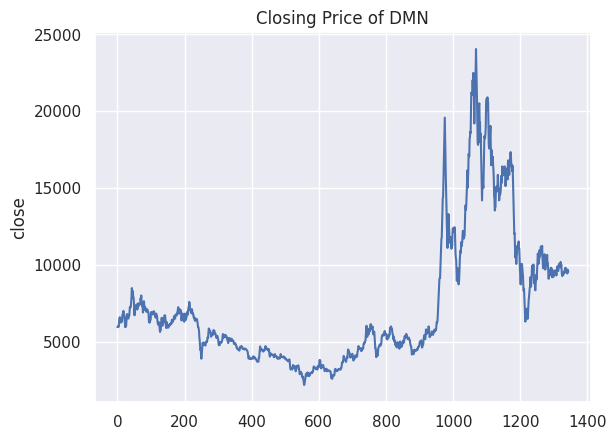

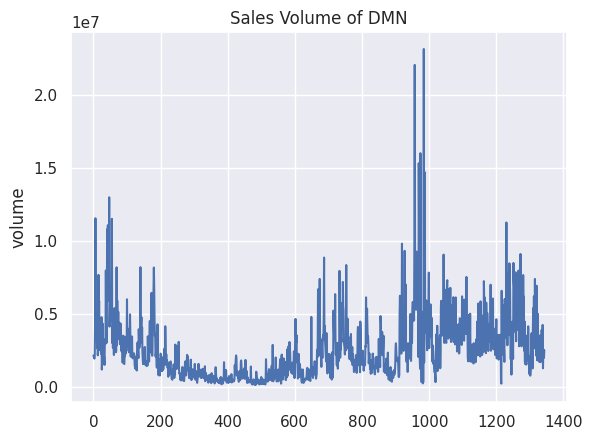

Average Volume:  2566654.4791666665


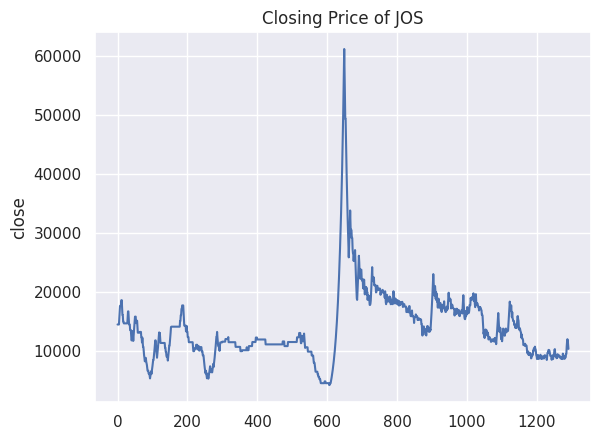

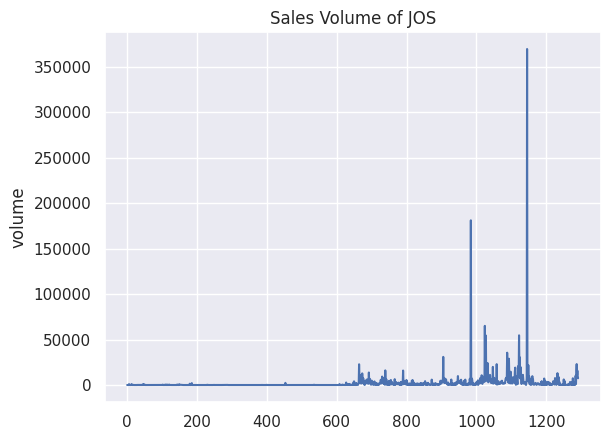

Average Volume:  2170.092879256966


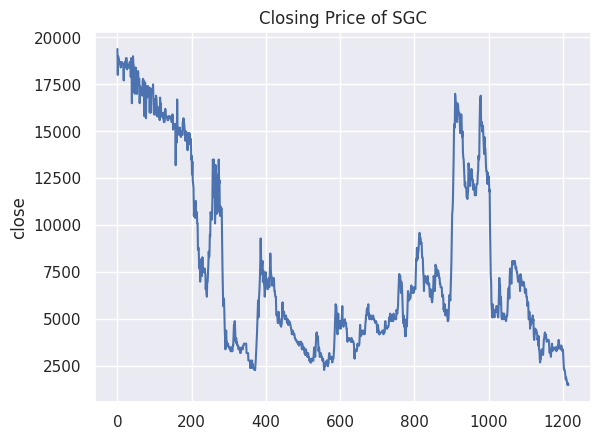

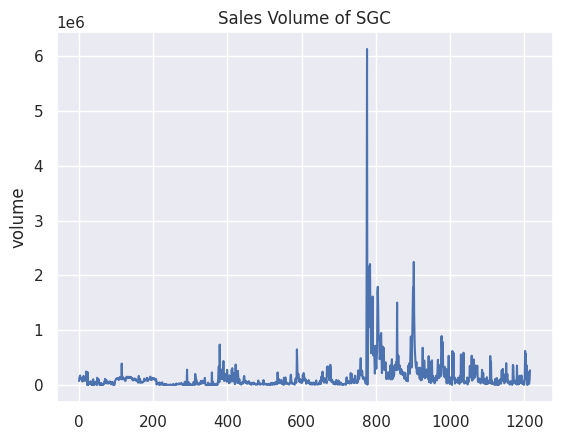

Average Volume:  147249.55180921053


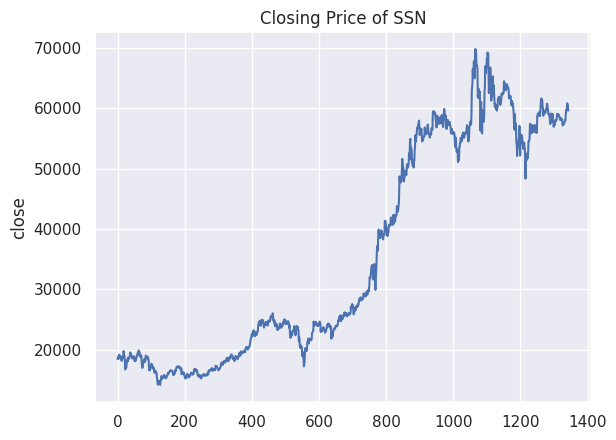

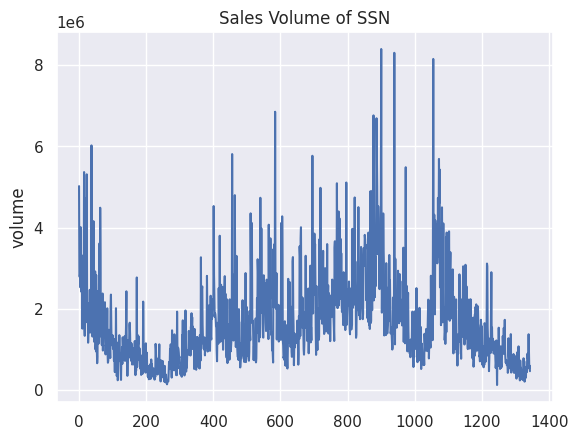

Average Volume:  1653657.9166666667


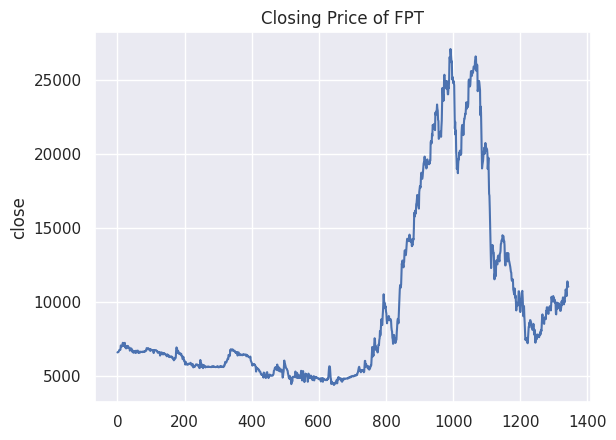

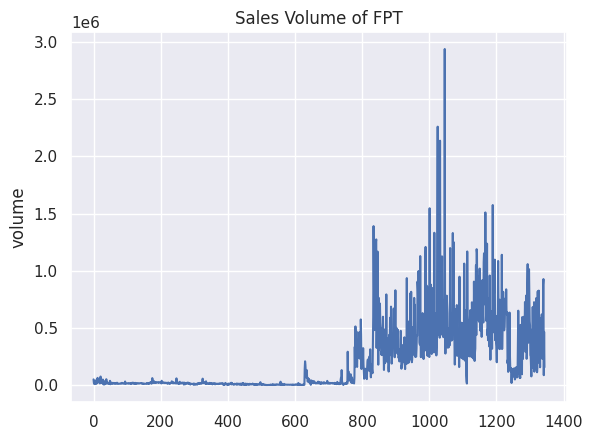

Average Volume:  206075.31994047618


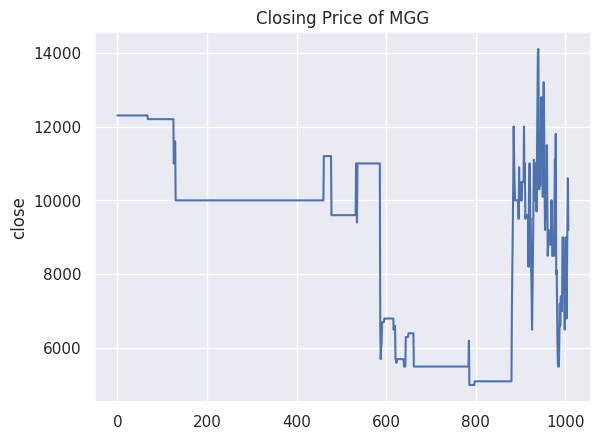

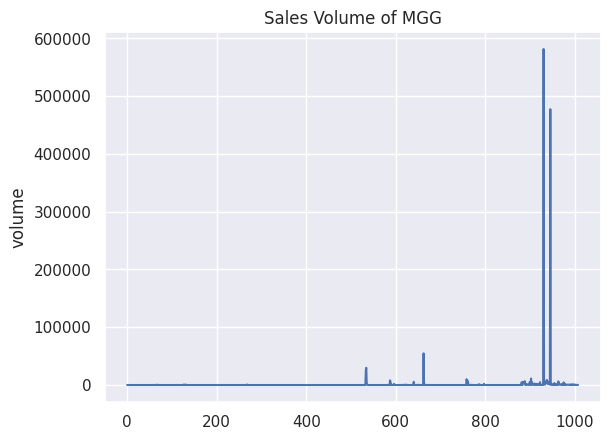

Average Volume:  1406.7460317460318


<Figure size 640x480 with 0 Axes>

In [ ]:
# Let's see a historical view of the closing price

# plt.subplots_adjust(top=1.25, bottom=1.2)
for i, company in enumerate(chosenRound1):
    plt.figure()
    company['close'].plot()
    plt.ylabel('close')
    plt.xlabel(None)
    plt.title(f"Closing Price of {lstChosen[i]}")
    plt.show()

    plt.figure()
    company['volume'].plot()
    plt.ylabel('volume')
    plt.xlabel(None)
    plt.title(f"Sales Volume of {lstChosen[i]}")
    plt.show()
    print("Average Volume: ", company['volume'].mean())
plt.tight_layout()

In [ ]:
### Reference: https://github.com/huseinzol05/Stock-Prediction-Models/blob/master/agent/2.moving-average-agent.ipynb
def buy_stock(
    real_movement,
    signal,
    initial_money = 1000000,
    max_buy = 1,
    max_sell = 1,
):
    """
    real_movement = actual movement in the real world
    delay = how much interval you want to delay to change our decision from buy to sell, vice versa
    initial_state = 1 is buy, 0 is sell
    initial_money = 1000, ignore what kind of currency
    max_buy = max quantity for share to buy
    max_sell = max quantity for share to sell
    """
    starting_money = initial_money
    states_sell = []
    states_buy = []
    current_inventory = 0

    def buy(i, initial_money, current_inventory):
        shares = initial_money // real_movement[i]
        if shares < 1:
            print(
                'day %d: total balances %f, not enough money to buy a unit price %f'
                % (i, initial_money, real_movement[i])
            )
        else:
            if shares > max_buy:
                buy_units = max_buy
            else:
                buy_units = shares
            initial_money -= buy_units * real_movement[i]
            current_inventory += buy_units
            print(
                'day %d: buy %d units at price %f, total balance %f'
                % (i, buy_units, buy_units * real_movement[i], initial_money)
            )
            states_buy.append(0)
        return initial_money, current_inventory

    for i in range(real_movement.shape[0] - int(0.025 * len(comp))):
        state = signal[i]
        if state == 1:
            initial_money, current_inventory = buy(
                i, initial_money, current_inventory
            )
            states_buy.append(i)
        elif state == -1:
            if current_inventory == 0:
                    print('day %d: cannot sell anything, inventory 0' % (i))
            else:
                if current_inventory > max_sell:
                    sell_units = max_sell
                else:
                    sell_units = current_inventory
                current_inventory -= sell_units
                total_sell = sell_units * real_movement[i]
                initial_money += total_sell
                try:
                    invest = (
                        (real_movement[i] - real_movement[states_buy[-1]])
                        / real_movement[states_buy[-1]]
                    ) * 100
                except:
                    invest = 0
                print(
                    'day %d, sell %d units at price %f, investment %f %%, total balance %f,'
                    % (i, sell_units, total_sell, invest, initial_money)
                )
            states_sell.append(i)
    invest = ((initial_money - starting_money) / starting_money) * 100
    total_gains = initial_money - starting_money
    return states_buy, states_sell, total_gains, invest

In [ ]:
portfolio = pd.DataFrame()

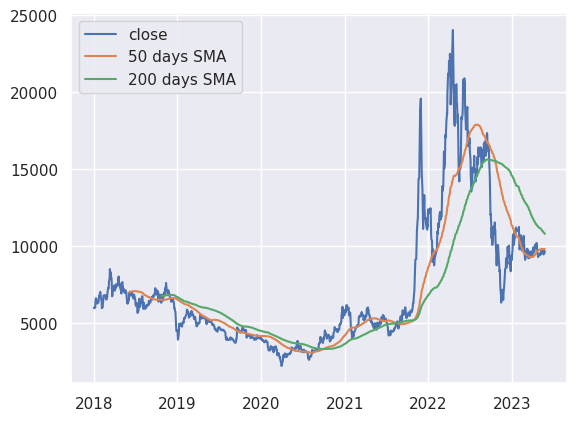

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 684: buy 1 units at price 4050.000000, total balance 995950.000000
day 902, sell 1 units at price 5050.000000, investment 24.691358 %, total balance 1001000.000000,
day 954: buy 1 units at price 6650.000000, total balance 994350.000000
day 1197, sell 1 units at price 11080.000000, investment 66.616541 %, total balance 1005430.000000,


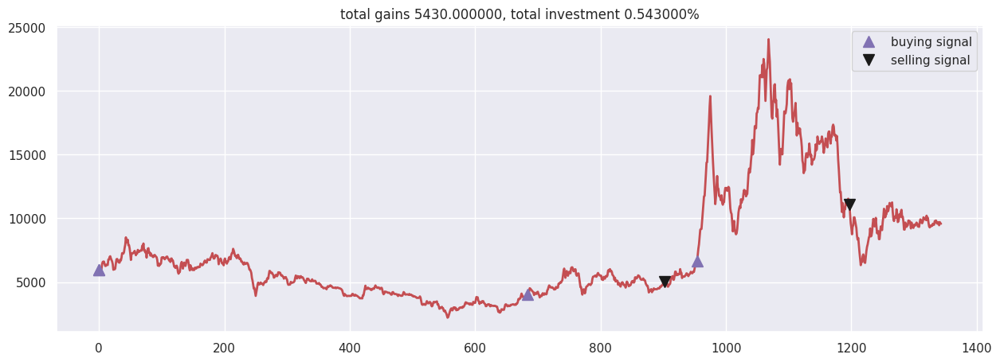

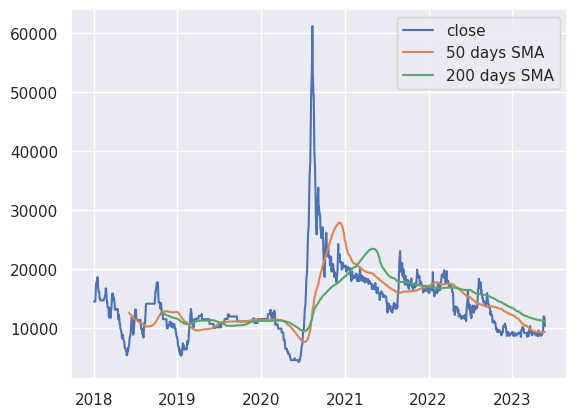

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 200: buy 1 units at price 13260.000000, total balance 986740.000000
day 277, sell 1 units at price 8320.000000, investment -37.254902 %, total balance 995060.000000,
day 373: buy 1 units at price 10130.000000, total balance 984930.000000
day 560, sell 1 units at price 9230.000000, investment -8.884501 %, total balance 994160.000000,
day 647: buy 1 units at price 53450.000000, total balance 940710.000000
day 781, sell 1 units at price 19030.000000, investment -64.396632 %, total balance 959740.000000,
day 975: buy 1 units at price 16810.000000, total balance 942930.000000
day 1060, sell 1 units at price 13120.000000, investment -21.951220 %, total balance 956050.000000,


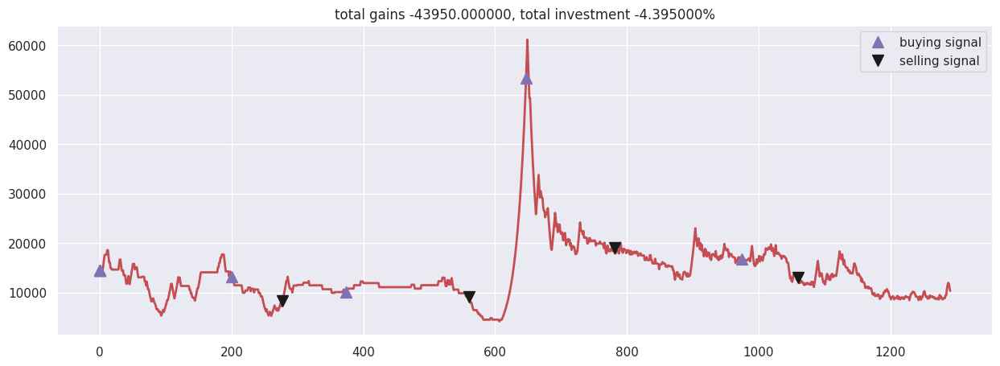

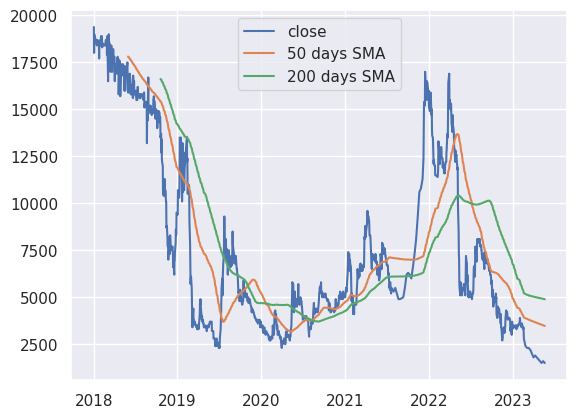

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 459: buy 1 units at price 5000.000000, total balance 995000.000000
day 513, sell 1 units at price 3200.000000, investment -36.000000 %, total balance 998200.000000,
day 649: buy 1 units at price 3600.000000, total balance 994600.000000
day 1047, sell 1 units at price 4900.000000, investment 36.111111 %, total balance 999500.000000,


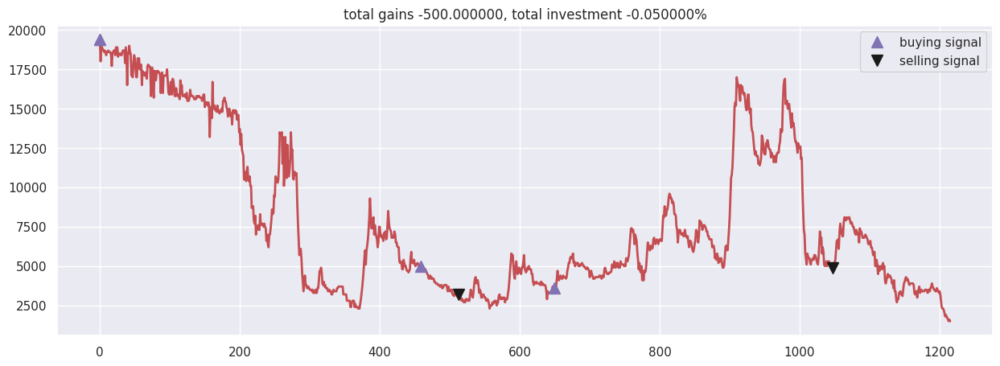

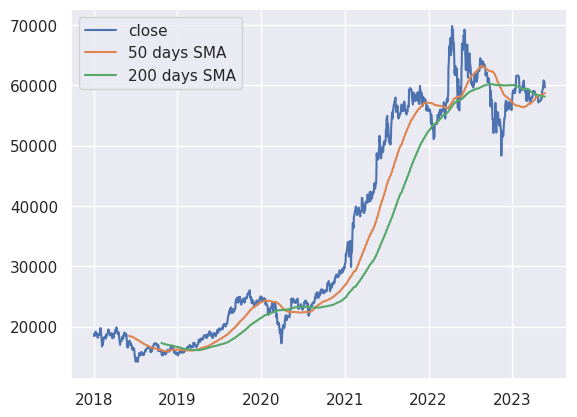

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 299: buy 1 units at price 16820.000000, total balance 983180.000000
day 566, sell 1 units at price 21370.000000, investment 27.051130 %, total balance 1004550.000000,
day 658: buy 1 units at price 24920.000000, total balance 979630.000000
day 1210, sell 1 units at price 53790.000000, investment 115.850722 %, total balance 1033420.000000,


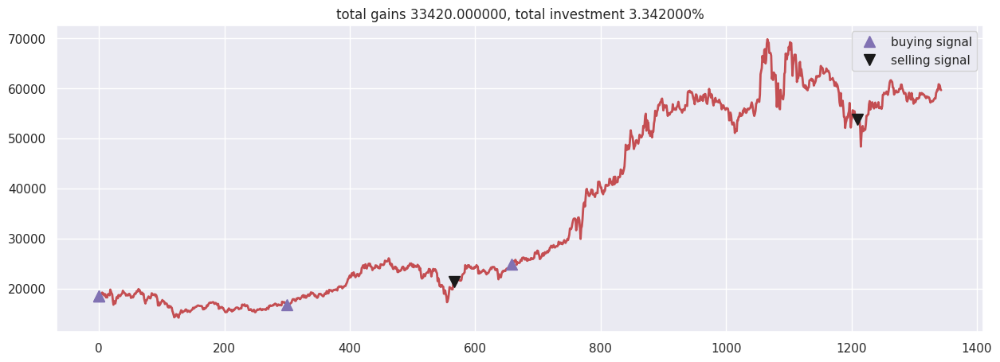

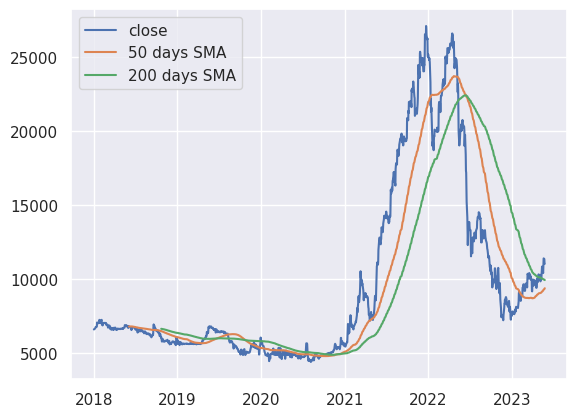

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 363: buy 1 units at price 6500.000000, total balance 993500.000000
day 450, sell 1 units at price 4860.000000, investment -25.230769 %, total balance 998360.000000,
day 727: buy 1 units at price 5350.000000, total balance 993010.000000
day 732, sell 1 units at price 5330.000000, investment -0.373832 %, total balance 998340.000000,
day 736: buy 1 units at price 5650.000000, total balance 992690.000000
day 1108, sell 1 units at price 17180.000000, investment 204.070796 %, total balance 1009870.000000,


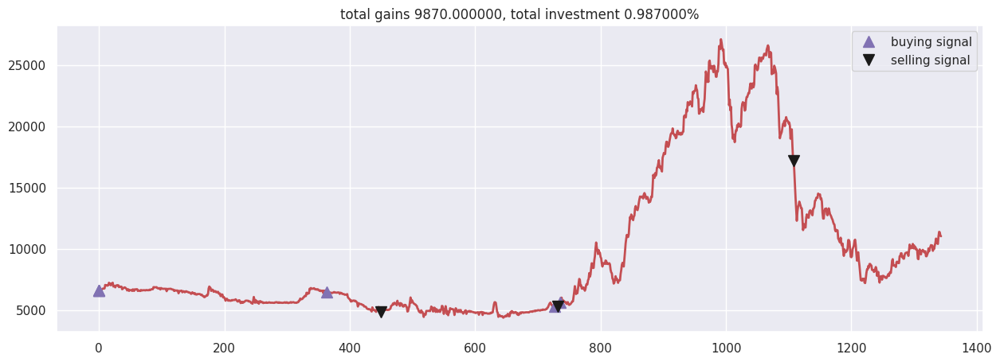

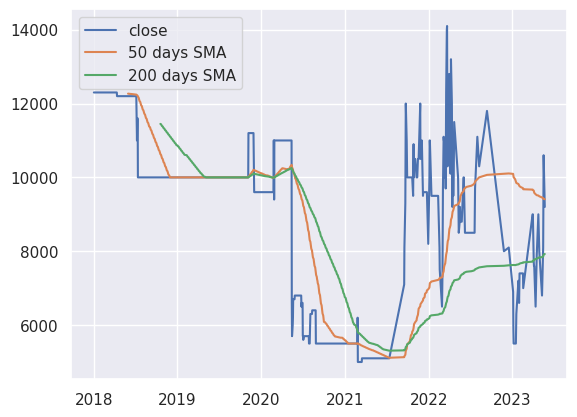

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


day 461: buy 1 units at price 11200.000000, total balance 988800.000000
day 528, sell 1 units at price 9600.000000, investment -14.285714 %, total balance 998400.000000,
day 534: buy 1 units at price 11000.000000, total balance 987400.000000
day 535, sell 1 units at price 9400.000000, investment -14.545455 %, total balance 996800.000000,
day 536: buy 1 units at price 11000.000000, total balance 985800.000000
day 592, sell 1 units at price 6700.000000, investment -39.090909 %, total balance 992500.000000,
day 889: buy 1 units at price 10000.000000, total balance 982500.000000


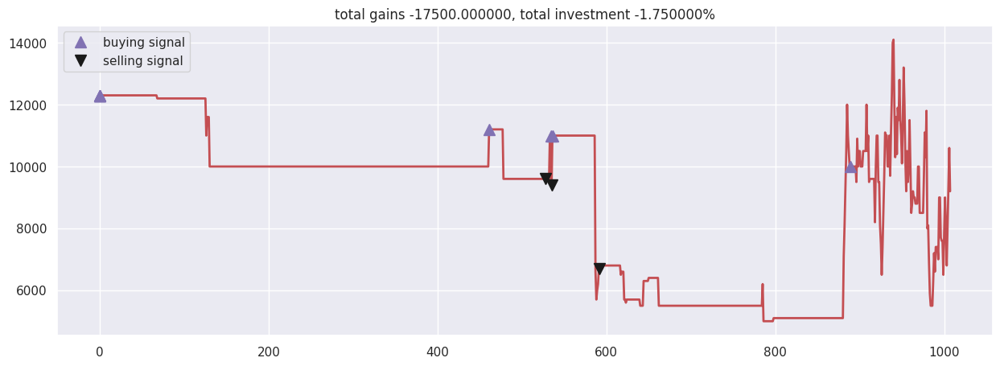

In [ ]:
for i, comp in enumerate(chosenRound1):
  portfolio.loc[i, 'company name'] = lstChosen[i]
  comp['50days'] = comp["close"].rolling(100).mean()
  comp['200days'] = comp["close"].rolling(200).mean()

  plt.plot(comp['time'], comp['close'], label = 'close')
  plt.plot(comp['time'], comp['50days'], label = '50 days SMA')
  plt.plot(comp['time'], comp['200days'], label = '200 days SMA')
  plt.legend()
  plt.show()

  comp['signal'] = 0
  comp['signal'][50:] = np.where(comp['50days'][50:]
                                              > comp['200days'][50:], 1.0, 0.0)
  comp['positions'] = comp['signal'].diff()

  states_buy, states_sell, total_gains, invest = buy_stock(comp.close, comp['positions'])

  portfolio.loc[i, 'total gain'] = total_gains
  portfolio.loc[i, 'invest'] = invest

  close = comp['close']
  fig = plt.figure(figsize = (15,5))
  plt.plot(close, color='r', lw=2.)
  plt.plot(close, '^', markersize=10, color='m', label = 'buying signal', markevery = states_buy)
  plt.plot(close, 'v', markersize=10, color='k', label = 'selling signal', markevery = states_sell)
  plt.title('total gains %f, total investment %f%%'%(total_gains, invest))

  plt.legend()
  plt.show()

In [ ]:
portfolio.rename(columns = {'invest': 'invest (%)'}, inplace =True)

In [ ]:
portfolio

,company name,total gain,invest (%)
0,DMN,5430.0,0.543
1,JOS,-43950.0,-4.395
2,SGC,-500.0,-0.050
3,SSN,33420.0,3.342
4,FPT,9870.0,0.987
5,MGG,-17500.0,-1.750


In [ ]:
portfolio.sort_values(['invest (%)'], ascending = False, inplace=True)

In [ ]:
portfolio.reset_index(inplace=True)
del portfolio['index']

In [ ]:
portfolio

,company name,total gain,invest (%)
0,SSN,33420.0,3.342
1,FPT,9870.0,0.987
2,DMN,5430.0,0.543
3,SGC,-500.0,-0.050
4,MGG,-17500.0,-1.750
5,JOS,-43950.0,-4.395
